# EDA: Global Wheat 

In [249]:
# standard library imports
import pathlib

# third party imports
import numpy as np
import pandas as pd

import PIL
from PIL import Image

import matplotlib.pyplot as plt 
import matplotlib.patches as patches
from matplotlib.collections import LineCollection
from matplotlib.lines import Line2D
import seaborn as sns

from skimage import exposure
from skimage.feature import hog
import cv2

# from IPython import display
# from IPython.display import Image

In [6]:
metadata = pd.read_csv('gwhd_2021/metadata_dataset.csv', sep=';')

In [7]:
metadata

,name,country,location,development_stage
0,Ethz_1,Switzerland,Usask,Filling
1,Rres_1,UK,Rothamsted,Filling - Ripening
2,ULiège-GxABT_1,Belgium,Gembloux,Ripening
3,NMBU_1,Norway,NMBU,Filling
4,NMBU_2,Norway,NMBU,Ripening
5,Arvalis_1,France,Gréoux,Post-flowering
6,Arvalis_2,France,Gréoux,Filling
7,Arvalis_3,France,Gréoux,Filling - Ripening
8,Arvalis_4,France,Gréoux,Filling
9,Arvalis_5,France,VLB,Filling


In [8]:
metadata.isna().sum()

name                 0
country              0
location             0
development_stage    0
dtype: int64

In [9]:
metadata.name.unique()

array(['Ethz_1', 'Rres_1', 'ULiège-GxABT_1', 'NMBU_1', 'NMBU_2',
       'Arvalis_1', 'Arvalis_2', 'Arvalis_3', 'Arvalis_4', 'Arvalis_5',
       'Arvalis_6', 'Arvalis_7', 'Arvalis_8', 'Arvalis_9', 'Arvalis_10',
       'Arvalis_11', 'Arvalis_12', 'Inrae_1', 'Usask_1', 'KSU_1', 'KSU_2',
       'KSU_3', 'KSU_4', 'Terraref_1', 'Terraref_2', 'CIMMYT_1',
       'CIMMYT_2', 'CIMMYT_3', 'Utokyo_1', 'Utokyo_2', 'Utokyo_3',
       'Ukyoto_1', 'NAU_1', 'NAU_2', 'NAU_3', 'UQ_1', 'UQ_2', 'UQ_3',
       'UQ_4', 'UQ_5', 'UQ_6', 'UQ_7', 'UQ_8', 'UQ_9', 'UQ_10', 'UQ_11',
       'ARC_1'], dtype=object)

In [10]:
metadata.country.unique()

array(['Switzerland', 'UK', 'Belgium', 'Norway', 'France', 'Canada', 'US',
       'Mexico', 'Japan', 'China', 'Australia', 'Sudan'], dtype=object)

In [11]:
metadata.location.unique()

array(['Usask', 'Rothamsted', 'Gembloux', 'NMBU', 'Gréoux', 'VLB', 'VSC',
       'Mons', 'Toulouse', 'Saskatchewan', 'KSU', 'Maricopa,AZ',
       ' Maricopa,AZ', 'Ciudad Obregon', 'NARO-Tsukuba', 'NARO-Hokkaido',
       'Kyoto', 'Baima', 'Gatton', 'McAllister', 'Brookstead',
       'Wad Medani'], dtype=object)

In [12]:
metadata.development_stage.unique()

array(['Filling', 'Filling - Ripening', 'Ripening', 'Post-flowering',
       'multiple', 'Post-Flowering'], dtype=object)

<hr style="border:2px solid gray"> </hr>

In [13]:
test = pd.read_csv('gwhd_2021/competition_test.csv')

In [14]:
test.isna().sum()

image_name     0
BoxesString    0
domain         0
dtype: int64

In [15]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1382 entries, 0 to 1381
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   image_name   1382 non-null   object
 1   BoxesString  1382 non-null   object
 2   domain       1382 non-null   object
dtypes: object(3)
memory usage: 32.5+ KB


In [16]:
len(test.image_name.unique())

1381

$\star$ Change `image_name` string to read `.jpg` instead of `.png` (the correct image format):

In [17]:
for i, row in test.iterrows():
    row['image_name'] = (row.image_name.split('.')[0]+'.jpg')

In [18]:
test.image_name[0]

'255b6ca9fea63f44125e5174bc932470b604c76043071522ba0ef63abb1a544b.jpg'

<hr style="border:2px solid gray"> </hr>

In [19]:
train = pd.read_csv('gwhd_2021/competition_train.csv')

In [20]:
train.isna().sum()

image_name     0
BoxesString    0
domain         0
dtype: int64

In [21]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3657 entries, 0 to 3656
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   image_name   3657 non-null   object
 1   BoxesString  3657 non-null   object
 2   domain       3657 non-null   object
dtypes: object(3)
memory usage: 85.8+ KB


In [22]:
len(train.image_name.unique())

3655

In [23]:
train[train.duplicated()]

,image_name,BoxesString,domain


In [24]:
train.image_name[train.image_name.duplicated()]

2070    d88963636d49127bda0597ef73f1703e92d6f111caefc4...
2079    1961bcf453d5b2206c428c1c14fe55d1f26f3c655db0a2...
Name: image_name, dtype: object

In [25]:
dupes = train.sort_values("image_name")
dupes[dupes.duplicated()]

,image_name,BoxesString,domain


In [26]:
train['image_name'].iloc[2070]

'd88963636d49127bda0597ef73f1703e92d6f111caefc44902d5932b8cd3fa94.png'

In [27]:
train['image_name'].iloc[2079]

'1961bcf453d5b2206c428c1c14fe55d1f26f3c655db0a2b6a83094476e8edb5b.png'

In [28]:
train.iloc[2070]

image_name     d88963636d49127bda0597ef73f1703e92d6f111caefc4...
BoxesString    312 994 364 1024;177 756 296 869;88 118 147 17...
domain                                                Arvalis_12
Name: 2070, dtype: object

In [29]:
train.iloc[2079]

image_name     1961bcf453d5b2206c428c1c14fe55d1f26f3c655db0a2...
BoxesString    3 944 58 985;876 506 919 555;770 859 834 903;9...
domain                                                Arvalis_12
Name: 2079, dtype: object

$\star$ Change `image_name` string to read `.jpg` instead of `.png` (the correct image format):

In [30]:
for i, row in train.iterrows():
    row['image_name'] = (row.image_name.split('.')[0]+'.jpg')

In [31]:
print(train.image_name[0])

4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e36f7c6aaf097c7ce423.jpg


<hr style="border:2px solid gray"> </hr>

In [32]:
val = pd.read_csv('gwhd_2021/competition_val.csv')

In [33]:
val.isna().sum()

image_name     0
BoxesString    0
domain         0
dtype: int64

In [34]:
val.head()

,image_name,BoxesString,domain
0,e6b6a900e5c54cd5d8b0649768c361512cff1813409319...,0 30 109 119;453 617 561 661;450 441 652 493;5...,Usask_1
1,53889799be1319296f102fa09a512463c27316a428bb9f...,38 370 88 443;924 824 964 874;0 191 39 265;828...,Usask_1
2,ec8f9365ca93eb9dab075c64e5c8b32edd4f8993e17b89...,884 932 1024 990;828 53 1024 206;607 633 681 7...,Usask_1
3,48bab0505514c876207b4ede1c60cc906947ca02bb4277...,284 114 352 181;421 0 533 90;910 326 954 409;8...,Usask_1
4,44bf4657132a886bea1b74e105c3aadfa41ba7a2ae9d7a...,94 0 241 183;173 217 318 338;401 371 606 472;3...,Usask_1


In [35]:
val.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1476 entries, 0 to 1475
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   image_name   1476 non-null   object
 1   BoxesString  1476 non-null   object
 2   domain       1476 non-null   object
dtypes: object(3)
memory usage: 34.7+ KB


In [36]:
len(val.image_name.unique())

1476

$\star$ Change `image_name` string to read `.jpg` instead of `.png` (the correct image format):

In [37]:
for i, row in val.iterrows():
    row['image_name'] = (row.image_name.split('.')[0]+'.jpg')

In [38]:
val.image_name[0]

'e6b6a900e5c54cd5d8b0649768c361512cff1813409319eba26da5c7f47bb2e6.jpg'

<hr style="border:2px solid gray"> </hr>

Plot sample image(s):

In [39]:
img = plt.imread('gwhd_2021/images/0007634580386bd39d4d0d24df58893c3bb967e12d6fc065ce8659e9acacc928.jpg')

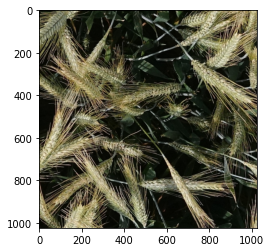

In [40]:
plt.imshow(img)

Check duplicate image names to see if they are also duplicated images:

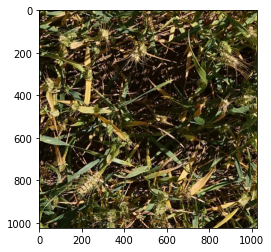

In [41]:
plt.imshow(plt.imread('gwhd_2021/images/d88963636d49127bda0597ef73f1703e92d6f111caefc44902d5932b8cd3fa94.jpg'))

In [42]:
#create data directory path and count images
data_dir = pathlib.Path('gwhd_2021/images')

Double-check that length of label csvs (train/test/val) matches total number of images:

In [43]:
len(list(data_dir.glob('*.jpg')))

6515

In [44]:
len(train) + len(test) + len(val)

6515

Great. Lengths match. Now let's check lengths of each set of labels to determine splits in image folder:

In [45]:
print('Length of training data is: {}'.format(len(train)))
print('Length of test data is: {}'.format(len(test)))
print('Length of val data is: {}'.format(len(val)))
print('Total length of all data is: {}'.format(len(list(data_dir.glob('*.jpg')))))

Length of training data is: 3657
Length of test data is: 1382
Length of val data is: 1476
Total length of all data is: 6515


$\star$ To split folder(s) at **folder sizes** or percentages: [see HERE](https://stackoverflow.com/questions/53074712/how-to-split-folder-of-images-into-test-training-validation-sets-with-stratified)
* Do this after all preprocessing etc. with folder sizes:
* **Train: 3657**
* **Test: 1382**
* **Val: 1476**

**TO-DO**
* Check classes distribution of wheat head type/location $\Rightarrow$ Image augmentation/generation to balance where necessary

In [46]:
images = list(data_dir.glob('*.jpg'))

In [47]:
#display first training image
#PIL.Image.open(str(images[0]))

In [48]:
#PIL.Image.open(str(images[5]))

In [49]:
#let's check image sizes for consistency:
sizes = []

for i in range(len(images)):
    size = PIL.Image.open(str(images[i])).size
    sizes.append(size) 
    
print("Set of possible image sizes:", set(sizes))

Set of possible image sizes: {(1024, 1024)}


Let's take a deeper look into the metadata:

In [50]:
train_domains = list(train.domain.unique())

In [51]:
train_domains

['Arvalis_1',
 'Arvalis_2',
 'Arvalis_3',
 'Arvalis_4',
 'Arvalis_5',
 'Arvalis_6',
 'Arvalis_7',
 'Arvalis_8',
 'Arvalis_9',
 'Arvalis_10',
 'Arvalis_11',
 'Arvalis_12',
 'ETHZ_1',
 'Inrae_1',
 'NMBU_1',
 'NMBU_2',
 'Rres_1',
 'ULiège-GxABT_1']

In [52]:
test_domains = list(test.domain.unique())

In [53]:
test_domains

['UQ_7',
 'UQ_8',
 'UQ_9',
 'UQ_10',
 'UQ_11',
 'Terraref_1',
 'Terraref_2',
 'KSU_1',
 'KSU_2',
 'KSU_3',
 'KSU_4',
 'CIMMYT_1',
 'CIMMYT_2',
 'CIMMYT_3',
 'Ukyoto_1',
 'NAU_2',
 'NAU_3',
 'ARC_1']

In [54]:
val_domains= list(val.domain.unique())

In [55]:
val_domains

['Usask_1',
 'Utokyo_1',
 'Utokyo_2',
 'Utokyo_3',
 'NAU_1',
 'UQ_1',
 'UQ_2',
 'UQ_3',
 'UQ_4',
 'UQ_5',
 'UQ_6']

In [56]:
def plot_six_by_origin(cl):
    
    #get six random indices belonging to the selected class
    indx = train[train['domain'] == cl].sample(6, axis=0).image_name.values
    #print(indx)
    
    #plot
    fig, axes = plt.subplots(2,3, figsize=(12,6))
    axes = axes.flatten()
    for i, ax in enumerate(axes):
        ax.imshow(PIL.Image.open(data_dir / indx[i]))
    fig.suptitle(cl, fontsize=18)
    plt.tight_layout()
    plt.show()

In [57]:
#plot_six_by_origin('Arvalis_1')

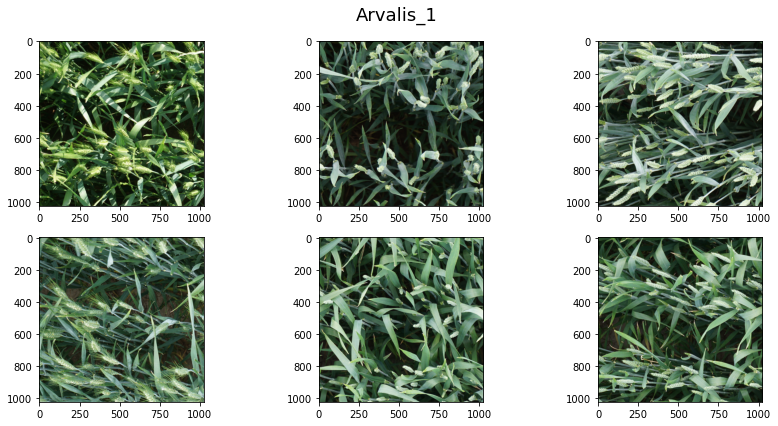

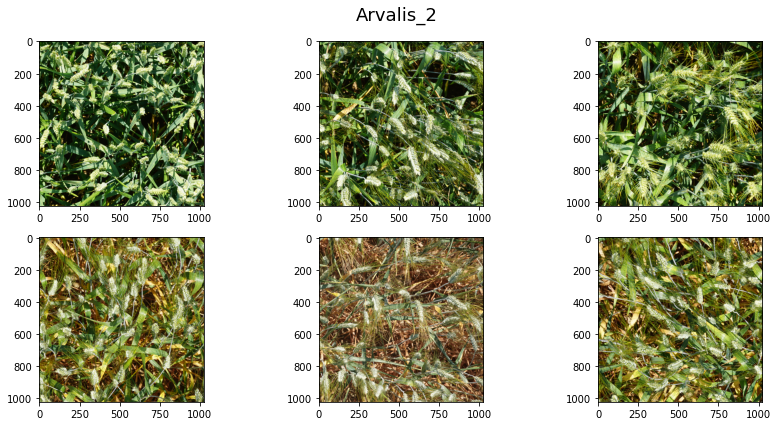

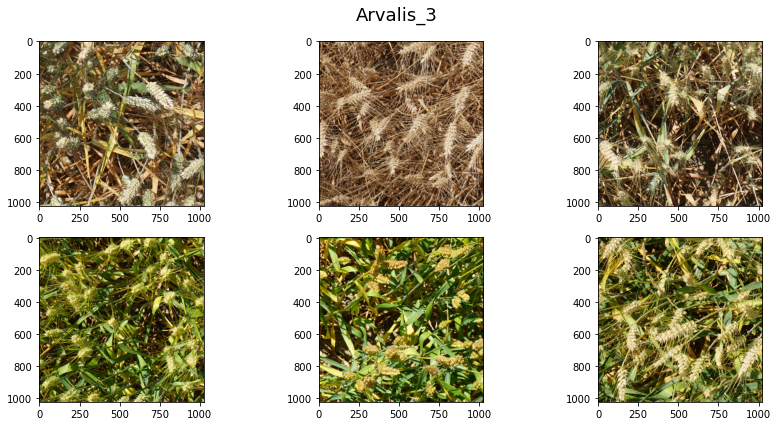

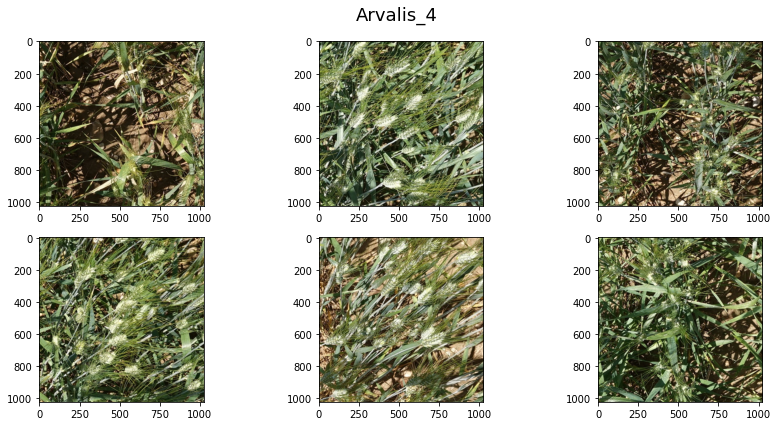

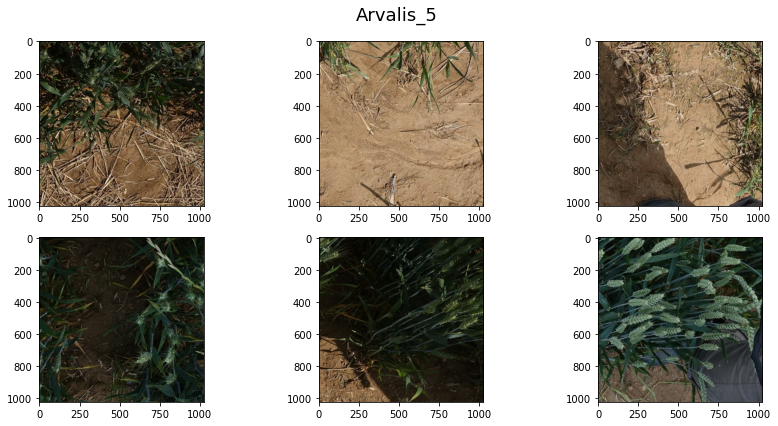

...

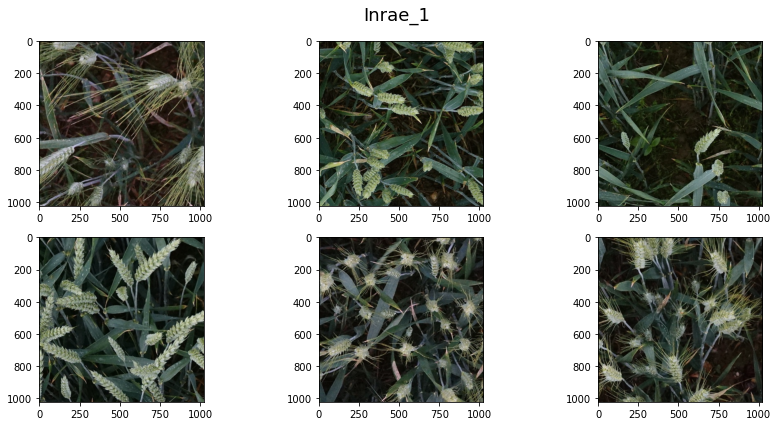

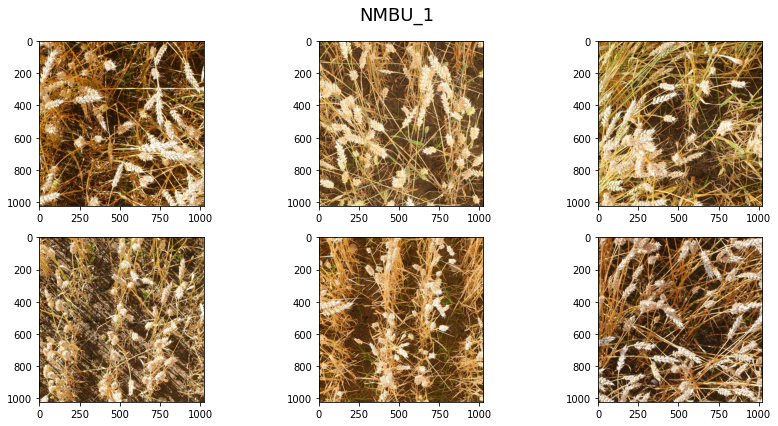

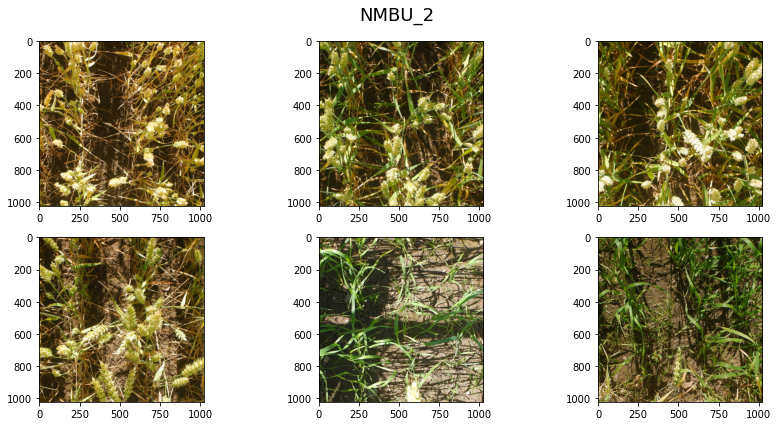

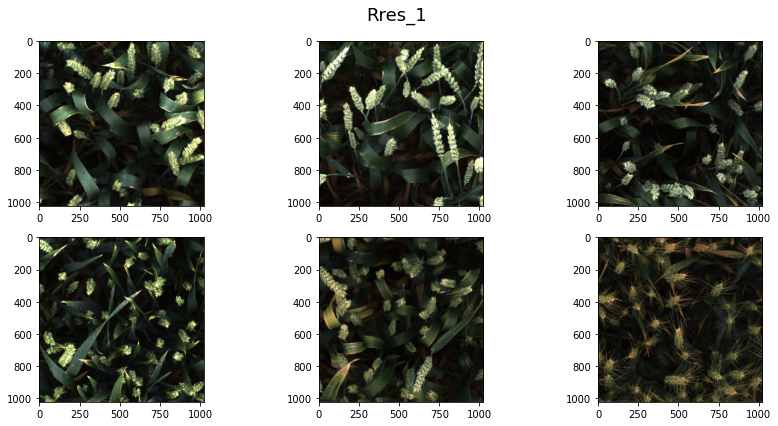

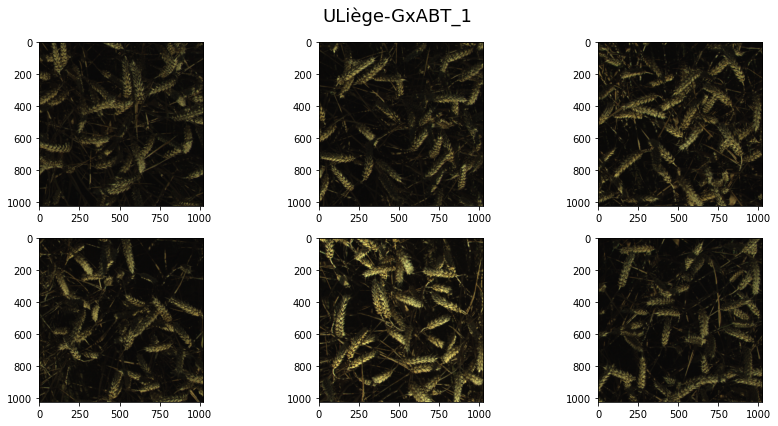

In [58]:
for i in train_domains:
    plot_six_by_origin(i)

Some of the wheat heads. This suggests that a larger input image size (higher resolution) may be beneficial to preserve the ability to identify small features/targets. 

<hr style="border:2px solid gray"> </hr>

Bounding boxes column is a list like column $\Rightarrow$ transform each into a separate row

For this $\Rightarrow$ pandas provides us with explode: **`df.explode()`**


Split bounding boxes column

<hr style="border:2px solid gray"> </hr>
<hr style="border:2px solid gray"> </hr>

In [59]:
for i, row in train.iterrows():
    row['BoxesString'] = list(row['BoxesString'].split(';'))
    
train = train.explode('BoxesString')
    
for i, row in train.iterrows():
    row['BoxesString'] = list(row['BoxesString'].split(' '))

In [60]:
train_df = train.copy()

In [61]:
train_df

,image_name,BoxesString,domain
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[99, 692, 160, 764]",Arvalis_1
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[641, 27, 697, 115]",Arvalis_1
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[935, 978, 1012, 1020]",Arvalis_1
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[377, 834, 463, 890]",Arvalis_1
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[654, 797, 696, 837]",Arvalis_1
...,...,...,...
3656,de85de89b3969fc6eb97d0c83299ad725a52595bde4533...,"[640, 1000, 700, 1024]",ULiège-GxABT_1
3656,de85de89b3969fc6eb97d0c83299ad725a52595bde4533...,"[365, 988, 450, 1024]",ULiège-GxABT_1
3656,de85de89b3969fc6eb97d0c83299ad725a52595bde4533...,"[534, 982, 635, 1023]",ULiège-GxABT_1
3656,de85de89b3969fc6eb97d0c83299ad725a52595bde4533...,"[608, 921, 820, 999]",ULiège-GxABT_1


The problem overview mentions that not all images have bounding boxes. Let's check how many of the images don't have bounding boxes and how these missing values are represented (so we can replace them). 

First, we'll check for null values.

In [62]:
train_df['BoxesString'].isna().sum()

0

No null values in the `BoxesString` column. If the problem overview was correct, and some of the images really are missing bounding boxes, they must be represented in some other way. Let's dig a little deeper. 

In [63]:
train_df2 = train_df.copy()

In [64]:
bbox_items = train_df2.BoxesString.to_list()

In [65]:
length_list = []
for item in bbox_items:
    length_list.append(len(item))

In [66]:
print(set(length_list))

{1, 4}


We know that bounding boxes are presented as lists of length 4, but the `BoxesString` column contains lists of both length 1 and length 4. It would appear that the missing bounding boxes are represented with a single value.

Let's locate the indices of the rows that contain a single element as a value for the `BoxesString` column:

In [67]:
one_rows = []
for i, item in enumerate(length_list):
    if item == 1:
        one_rows.append(i)

Let's take a look at the first five indices:

In [68]:
one_rows[:5]

[50240, 50254, 50440, 50800, 51065]

In [69]:
train_df.iloc[50240,:]

image_name     6b06b7b2a64a2bf87daa760f754b44efaaeb69da6454d6...
BoxesString                                             [no_box]
domain                                                 Arvalis_5
Name: 1264, dtype: object

Images with no bounding boxes are indicated with a list containing the single string element `no_box`. Let's change that to a list of all `0`s.

In [70]:
train_df2 = train_df.copy()

In [71]:
train_df2.BoxesString = train_df2.BoxesString.apply(lambda y: list('0 0 0 0'.split(" ")) if len(y)==1 else y)

In [72]:
train_df2.iloc[50240,:]

image_name     6b06b7b2a64a2bf87daa760f754b44efaaeb69da6454d6...
BoxesString                                         [0, 0, 0, 0]
domain                                                 Arvalis_5
Name: 1264, dtype: object

Now let's expand `BoxesString` into separate columns:

In [73]:
train_df3 = train_df2.copy()

In [74]:
lst_type = []
for lst in train_df3.BoxesString:
    for element in lst:
        lst_type.append(type(element))
print(set(lst_type))

{<class 'str'>}


In [75]:
lst_type2 = []
for element in train_df3.BoxesString:
    lst_type2.append(type(element))
print(set(lst_type2))    

{<class 'list'>}


The `BoxesString` column contains values of type list and string. This is because the original bounding box values are of type list, and we replaced the missing values with string values (`[0, 0, 0, 0]`). Let's convert all the values to lists in order to separate the individual bounding box values

In [76]:
bbox_xmin = []
bbox_ymin = []
bbox_width = []
bbox_height = []

In [77]:
df_lst = list(train_df3.BoxesString)

In [78]:
for bbox_lst in df_lst:
    bbox_xmin.append(bbox_lst[0])
    bbox_ymin.append(bbox_lst[1])
    bbox_width.append(bbox_lst[2])
    bbox_height.append(bbox_lst[3])

In [79]:
train_df3['bbox_xmin'] = bbox_xmin
train_df3['bbox_ymin'] = bbox_ymin
train_df3['bbox_xmax'] = bbox_width
train_df3['bbox_ymax'] = bbox_height

In [80]:
train_df3.head()

,image_name,BoxesString,domain,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[99, 692, 160, 764]",Arvalis_1,99,692,160,764
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[641, 27, 697, 115]",Arvalis_1,641,27,697,115
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[935, 978, 1012, 1020]",Arvalis_1,935,978,1012,1020
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[377, 834, 463, 890]",Arvalis_1,377,834,463,890
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[654, 797, 696, 837]",Arvalis_1,654,797,696,837


In [81]:
train_df3.reset_index(inplace=True, drop=True)

In [82]:
train_df3

,image_name,BoxesString,domain,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[99, 692, 160, 764]",Arvalis_1,99,692,160,764
1,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[641, 27, 697, 115]",Arvalis_1,641,27,697,115
2,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[935, 978, 1012, 1020]",Arvalis_1,935,978,1012,1020
3,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[377, 834, 463, 890]",Arvalis_1,377,834,463,890
4,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[654, 797, 696, 837]",Arvalis_1,654,797,696,837
...,...,...,...,...,...,...,...
163735,de85de89b3969fc6eb97d0c83299ad725a52595bde4533...,"[640, 1000, 700, 1024]",ULiège-GxABT_1,640,1000,700,1024
163736,de85de89b3969fc6eb97d0c83299ad725a52595bde4533...,"[365, 988, 450, 1024]",ULiège-GxABT_1,365,988,450,1024
163737,de85de89b3969fc6eb97d0c83299ad725a52595bde4533...,"[534, 982, 635, 1023]",ULiège-GxABT_1,534,982,635,1023
163738,de85de89b3969fc6eb97d0c83299ad725a52595bde4533...,"[608, 921, 820, 999]",ULiège-GxABT_1,608,921,820,999


In [83]:
train_df3["bbox_xmin"] = pd.to_numeric(train_df3["bbox_xmin"], downcast="float")
train_df3["bbox_ymin"] = pd.to_numeric(train_df3["bbox_ymin"], downcast="float")
train_df3["bbox_xmax"] = pd.to_numeric(train_df3["bbox_xmax"], downcast="float")
train_df3["bbox_ymax"] = pd.to_numeric(train_df3["bbox_ymax"], downcast="float")

In [84]:
train_df3.head()

,image_name,BoxesString,domain,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[99, 692, 160, 764]",Arvalis_1,99.0,692.0,160.0,764.0
1,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[641, 27, 697, 115]",Arvalis_1,641.0,27.0,697.0,115.0
2,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[935, 978, 1012, 1020]",Arvalis_1,935.0,978.0,1012.0,1020.0
3,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[377, 834, 463, 890]",Arvalis_1,377.0,834.0,463.0,890.0
4,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[654, 797, 696, 837]",Arvalis_1,654.0,797.0,696.0,837.0


In [85]:
# Take dataframe and image_name for which we want bounding boxes and return list of x, y, w, h

def get_all_bboxes(df, image_name):
    image_bounding_boxes = df[df.image_name == image_name]
  
    bounding_boxes = []
    for _, row in image_bounding_boxes.iterrows():
        bounding_boxes.append((row.bbox_xmin, row.bbox_ymin, row.bbox_xmax-row.bbox_xmin, row.bbox_ymax-row.bbox_ymin))
    
    return bounding_boxes

In [86]:
# Plot examples of images with their bounding boxes

def plot_image_examples(dataframe, rows = 3, cols = 3, title = 'Image examples', size = (10, 10)):
    fig, axs = plt.subplots(rows, cols, figsize=size)
    for row in range(rows):
        for col in range(cols):
            idx = np.random.randint(len(dataframe), size = 1)[0]
            img_id = dataframe.iloc[idx].image_name
      
            img = Image.open(data_dir / img_id)
            axs[row, col].imshow(img)
      
            bboxes = get_all_bboxes(dataframe, img_id)
      
            for bbox in bboxes:
                rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=1, edgecolor='r', facecolor='none')
                axs[row, col].add_patch(rect)
        
                axs[row, col].axis('off')    
    plt.suptitle(title, fontsize = 18)

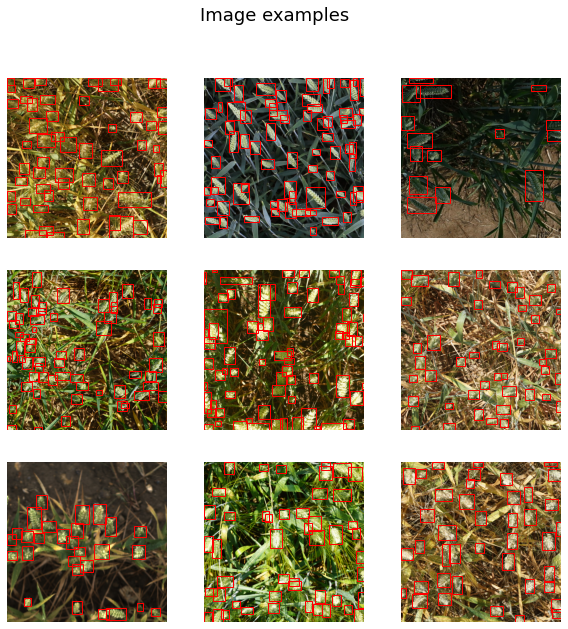

In [87]:
plot_image_examples(train_df3)

Create dataframe `train_count` with column indicating total number of bounding boxes (`bbox_count`) per image. We will use this to identify images with greater and fewer numbers of bounding boxes.

### Bounding boxes per image

In [88]:
train_df4 = train_df3.copy()

In [89]:
train_df4['bbox_count'] = 1
train_count = train_df4.groupby('image_name').sum().reset_index()
train_count

,image_name,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax,bbox_count
0,0007634580386bd39d4d0d24df58893c3bb967e12d6fc0...,22215.0,19188.0,28532.0,25230.0,47
1,00417fc37a35f14ce3044bf2ae6c76d19bf42a426a9403...,16841.0,15744.0,20006.0,18905.0,37
2,004b381a051838dc0cc8ff293e09823faa1dd6f26e82ff...,29883.0,28356.0,33617.0,32855.0,59
3,004ccec5da561b85d8b05ed11c071ac9ef3af5c8c9a1d6...,18726.0,19818.0,22338.0,23766.0,43
4,006f18cc577457d0d0b987d1af19e5568541cc5f84e143...,41054.0,37345.0,45453.0,42030.0,83
...,...,...,...,...,...,...
3650,ff93ccb206f49b83feacc20d245862ed41336ecb04a417...,1082.0,545.0,1307.0,807.0,4
3651,ffa790ef2ab2aeed5bb6f4f54cc0f909f23f2352fe3ba3...,19216.0,20729.0,22671.0,23884.0,41
3652,ffbf32e12b7d53aa6d7ceeaca94e1ab9706800b2cef9bb...,12888.0,12361.0,14716.0,14264.0,25
3653,ffc7fee025ebc4e763d0e250fdf6ee07666396882584e3...,28546.0,30122.0,35977.0,37123.0,61


Let's define a function to effectively plot a rugplot at the *top* of our distribution plots:

In [90]:
def upper_rugplot(data, height=.03, ax=None, **kwargs):
    ax = ax or plt.gca()
    kwargs.setdefault("linewidth", 1)
    segs = np.stack((np.c_[data, data],
                     np.c_[np.ones_like(data), np.ones_like(data)-height]),
                    axis=-1)
    lc = LineCollection(segs, transform=ax.get_xaxis_transform(), **kwargs)
    ax.add_collection(lc)

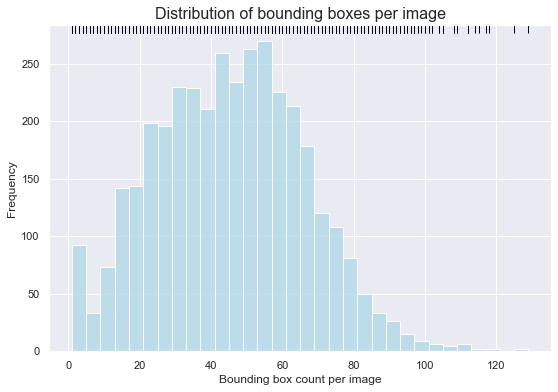

In [91]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax= plt.subplots()
sns.histplot(data=train_count, x="bbox_count",color = 'lightblue')
#sns.rugplot(data=train_count, x="bbox_count", color='black')
plt.title("Distribution of bounding boxes per image", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Bounding box count per image')

upper_rugplot(train_count.bbox_count, ax=ax, color= 'black', height = 0.025)

plt.show()

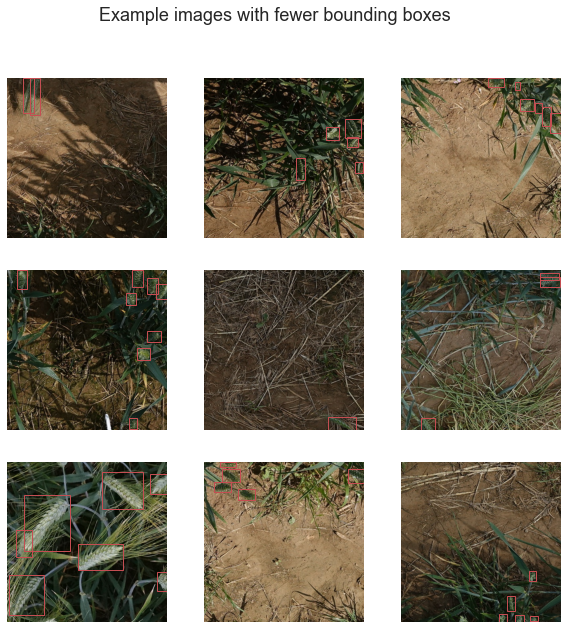

In [92]:
# Plot example images with fewer bounding boxes
fewer_bboxes = train_count[train_count['bbox_count'] < 10].image_name
plot_image_examples(train_df3[train_df3.image_name.isin(fewer_bboxes)], 
                    title= "Example images with fewer bounding boxes")

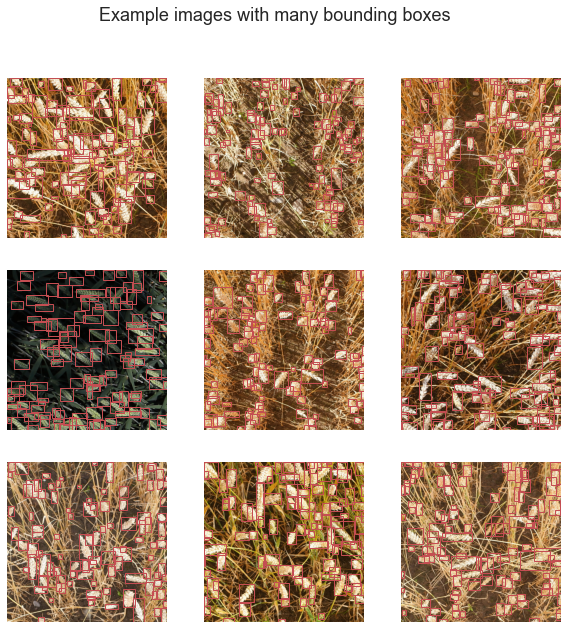

In [93]:
# Example images with a lot of bounding boxes
many_bboxes = train_count[train_count['bbox_count'] > 100].image_name
plot_image_examples(train_df3[train_df3.image_name.isin(many_bboxes)], 
                    title='Example images with many bounding boxes')

### Bounding box area

Let's add a column for the area of each given bounding box. This will help us to determine outliers/incorrectly assigned bounding boxes.

In [94]:
train_df5= train_df3.copy()

In [95]:
train_df5['area'] = (train_df5.bbox_xmax - train_df5.bbox_xmin) * (train_df5.bbox_ymax - train_df5.bbox_ymin)

In [96]:
train_df5.head()

,image_name,BoxesString,domain,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax,area
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[99, 692, 160, 764]",Arvalis_1,99.0,692.0,160.0,764.0,4392.0
1,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[641, 27, 697, 115]",Arvalis_1,641.0,27.0,697.0,115.0,4928.0
2,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[935, 978, 1012, 1020]",Arvalis_1,935.0,978.0,1012.0,1020.0,3234.0
3,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[377, 834, 463, 890]",Arvalis_1,377.0,834.0,463.0,890.0,4816.0
4,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[654, 797, 696, 837]",Arvalis_1,654.0,797.0,696.0,837.0,1680.0


Let's explore the distributions of the measurements of our bounding boxes:

In [97]:
print('Max bbox area: {}'.format(max(train_df5.area)))
print('Min bbox area: {}'.format(min(train_df5.area)))

Max bbox area: 387960.0
Min bbox area: 0.0


<hr style="border:2px solid gray"> </hr>

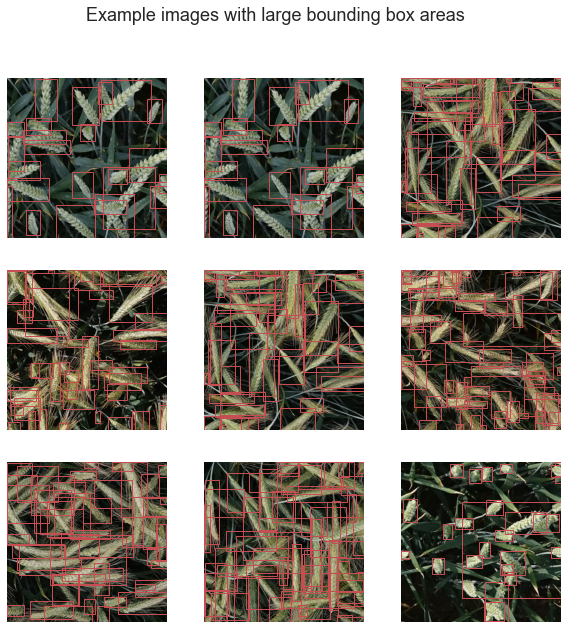

In [98]:
# Example images with large bounding box areas
large_boxes_ids = train_df5[train_df5['area'] > 100000].image_name
plot_image_examples(train_df5[train_df5.image_name.isin(large_boxes_ids)], 
                    title='Example images with large bounding box areas')

It appears that some large bounding boxes may be errors, but many large bounding boxes are correct (and their size due to the proximity of the camera, as well as the position- often diagonal- of the wheat heads in the image). We will address this later on in the notebook.

Note that when defining the images with small bounding boxes, we will need to specify areas larger than 0, since we replaced missing bounding box values with arrays of zeros.

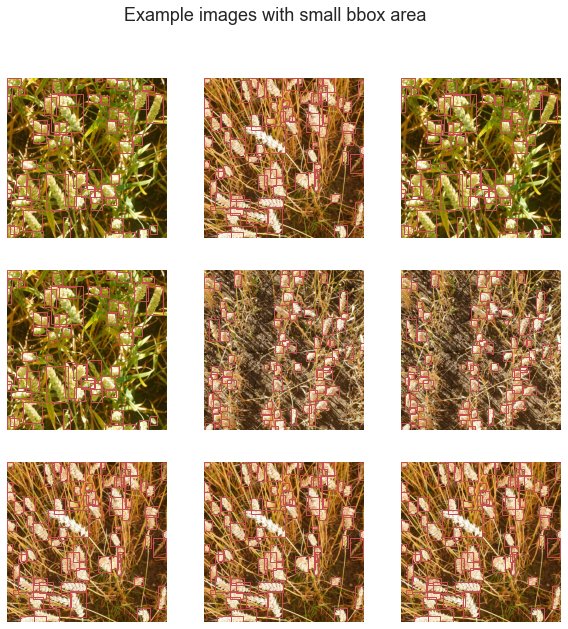

In [99]:
# Example images with small bounding box area
# Must specify greater than 0
small_boxes_ids = train_df5[(train_df5['area'] < 50) & (train_df5['area'] > 0)].image_name
plot_image_examples(train_df5[train_df5.image_name.isin(small_boxes_ids)], 
                    title='Example images with small bbox area')

In [100]:
# Not correct bc bounding boxes overlap!!!!

# compute the total bounding boxes area per image
#area_per_image = train_df5.groupby(by='image_name').sum().reset_index()

# compute the percentage of the image area covered by bounding boxes
#area_per_image_percentage = area_per_image.copy()
#area_per_image_percentage['area'] = area_per_image_percentage['area'] / (1024*1024) * 100

<hr style="border:2px solid gray"> </hr>

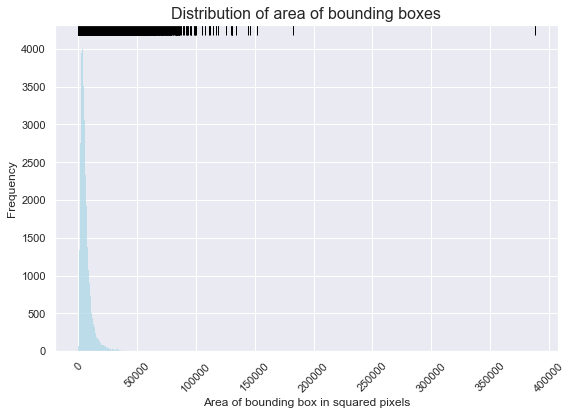

In [101]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
sns.histplot(data=train_df5, x="area",
             color = 'lightblue')
#sns.rugplot(data=train_df5, x="area", color='black')
plt.title("Distribution of area of bounding boxes", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Area of bounding box in squared pixels')
plt.xticks(rotation=45)

upper_rugplot(train_df5.area, ax=ax, color = 'black')

plt.show()

Notice that there is one bounding box with a total aread of about 380,000 pixels. This is very likely an outlier. Let's examine the image with this bounding box first, before addressing, however. 

(-0.5, 1023.5, 1023.5, -0.5)

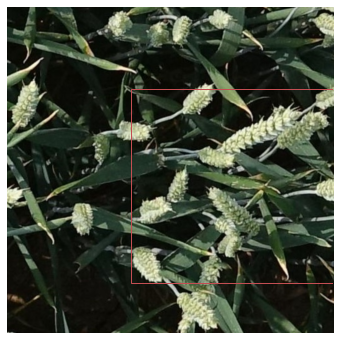

In [102]:
big_bbox_idx = train_df5[train_df5.area >= 350000].index.to_list()[0]
big_img_id = train_df5.iloc[big_bbox_idx].image_name
big_img = Image.open(data_dir / big_img_id)
fig, ax = plt.subplots()
ax.imshow(big_img)
rect = patches.Rectangle((train_df5.iloc[big_bbox_idx].bbox_xmin, train_df5.iloc[big_bbox_idx].bbox_ymin), 
                          train_df5.iloc[big_bbox_idx].bbox_xmax - train_df5.iloc[big_bbox_idx].bbox_xmin, 
                          train_df5.iloc[big_bbox_idx].bbox_ymax - train_df5.iloc[big_bbox_idx].bbox_ymin,
                          linewidth=1, edgecolor='r', facecolor='none')
ax.add_patch(rect)
ax.axis('off') 

Let's view this image with all bounding boxes as well. For this, we'll build a function, `plot_image_with_bboxes()`, as we'll want to be able to do this again in the future with other images. 

In [103]:
# Plot single image with all bounding boxes
def plot_image_with_bboxes(dataframe, img_name, title = 'Image examples', size = (5, 5)):
    fig, ax = plt.subplots(figsize=size)
    img = Image.open(data_dir / img_name)
    ax.imshow(img)
      
    bboxes = get_all_bboxes(dataframe, img_name)
      
    for bbox in bboxes:
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        
        ax.axis('off')    
    plt.suptitle(title, fontsize = 16)

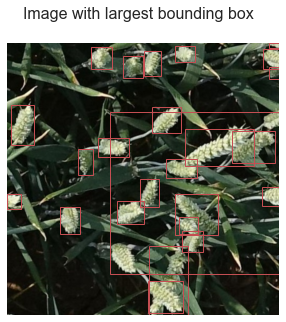

In [104]:
plot_image_with_bboxes(train_df5, img_name=big_img_id, title='Image with largest bounding box')

This large bounding appears to be an outlier. Instead of continuing to check images one by one for errors, however, let's determine a reasonable maximum to cap bounding box areas and remove suspected incorrect/accidental bounding boxes.

In [105]:
train_df5.shape

(163740, 8)

Note that we have a **total** of **163,740 bounding boxes** in our entire DataFrame, and over 160,000 of those bounding boxes have areas under 50,000 square pixels. Clearly we have a few more outliers; let's replot and check the distriution of bounding boxes with areas under 100,000:

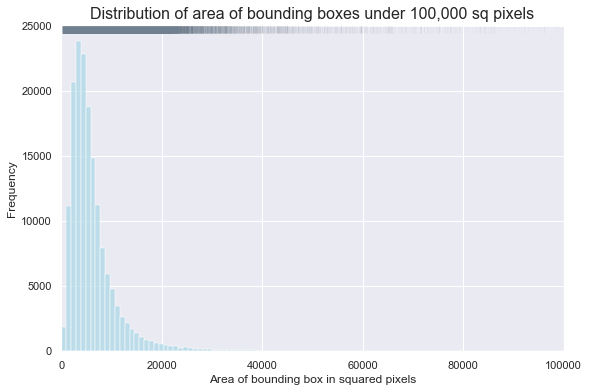

In [106]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
plt.xlim(0,100000)
sns.histplot(data=train_df5, x="area", color = 'lightblue', bins=400)
#sns.rugplot(data=train_df5, x="area", color='black', alpha=.1)
plt.title("Distribution of area of bounding boxes under 100,000 sq pixels", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Area of bounding box in squared pixels')

upper_rugplot(train_df5.area, ax=ax, alpha= 0.03,color= 'slategray', height = 0.025)

plt.show()

Let's try below 40,000:

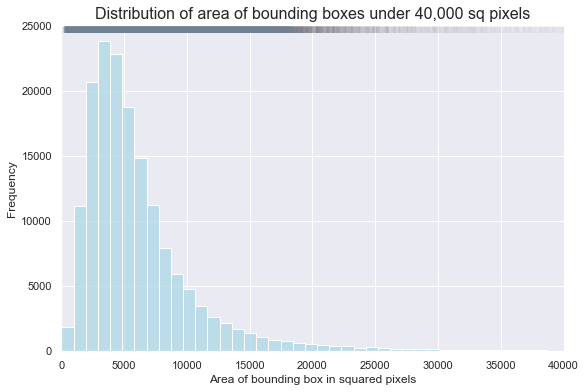

In [107]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
plt.xlim(0,40000)
sns.histplot(data=train_df5, x="area", color = 'lightblue', bins=400)
#sns.rugplot(data=train_df5, x="area", color='black', lw = 0.2, alpha=.1)
plt.title("Distribution of area of bounding boxes under 40,000 sq pixels", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Area of bounding box in squared pixels')

upper_rugplot(train_df5.area, ax=ax, alpha= 0.03, color= 'slategray', height = 0.025, linewidth=0.3)

plt.show()

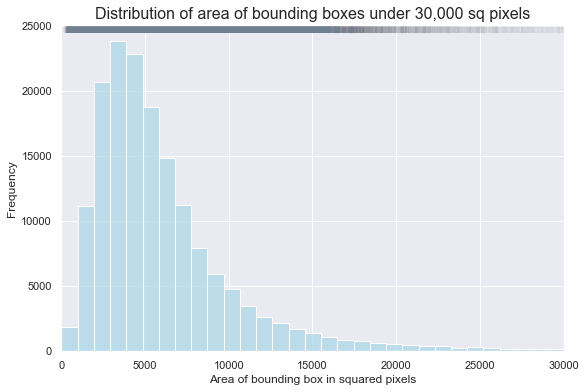

In [108]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
plt.xlim(0,30000)
sns.histplot(data=train_df5, x="area", color = 'lightblue', bins=400)
#sns.rugplot(data=train_df5, x="area", color='black', lw = 0.2, alpha=.1)
plt.title("Distribution of area of bounding boxes under 30,000 sq pixels", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Area of bounding box in squared pixels')

upper_rugplot(train_df5.area, ax=ax, alpha= 0.03,color= 'slategray', height = 0.025, linewidth=0.3)

plt.show()


$\star$ **As determined in our plot of random examples of images with large bounding boxes, it seems that most are accurate. Therefore, let's *just* drop our one obvious outlier and keep the rest. We may need to take into consideration this unbalanced class distribution when training, however.**

Now, let's take a look at image qualities like brightness and darkness, and RGB channel intensities. First, we'll define a couple of functions to determine the brightness of images. 

In [109]:
# Create copy of dataframe to add new brightness column
# Not necessary?
train_df6 = train_df5.copy()

In [110]:
def get_image_brightness(image):
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # get average brightness
    return np.array(gray).mean()

In [111]:
def add_brightness_column(df):
    brightness = []
    for _, row in df.iterrows():
        img_id = row.image_name
        image = cv2.imread(str(data_dir / img_id))
        brightness.append(get_image_brightness(image))
        
    brightness_df = pd.DataFrame(brightness)
    brightness_df.columns = ['brightness']
    df = pd.concat([df, brightness_df], ignore_index=True, axis=1)
    df.columns = ['image_name', 'brightness']
    
    return df

In [112]:
images_df = pd.DataFrame(train_df6.image_name.unique())
images_df.columns = ['image_name']

In [113]:
brightness_df = add_brightness_column(images_df)

In [114]:
brightness_df.head()

,image_name,brightness
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,85.802637
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,91.932296
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,85.085322
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,83.631724
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,87.268487


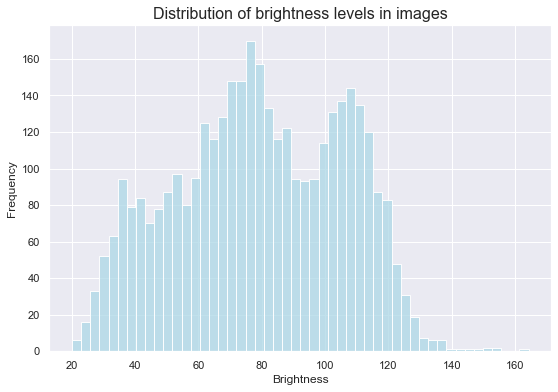

In [115]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
#plt.xlim(0,100000)
sns.histplot(data=brightness_df, x="brightness", color = 'lightblue', bins=50)
#sns.rugplot(data=train_df5, x="area", color='black', alpha=.1)
plt.title("Distribution of brightness levels in images", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Brightness')

plt.show()

In [116]:
# Define legend elements for all dist plots with mean and cutoff axvlines
leg_els = [Line2D([0], [0], color='darkviolet', lw=1, label='mean'),
                   Line2D([0], [0], lw=1, ls = '-.', label='cut-off')]

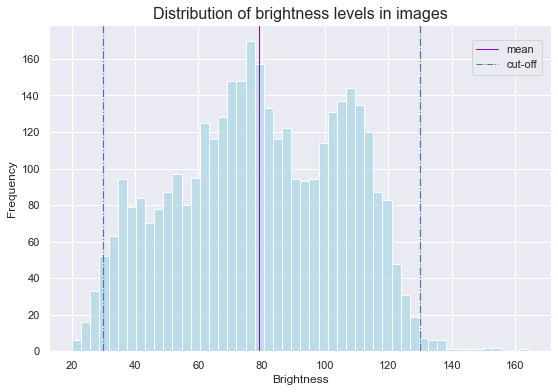

In [117]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
#plt.xlim(0,100000)
sns.histplot(data=brightness_df, x="brightness", color = 'lightblue', bins=50)
#sns.rugplot(data=train_df5, x="area", color='black', alpha=.1)
plt.title("Distribution of brightness levels in images", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Brightness')

plt.axvline(x=30,linestyle='-.', linewidth=1.2)
plt.axvline(x=130,linestyle='-.', linewidth=1.2)
#upper_rugplot(train_df.brightness, ax=ax, alpha= 0.002, linewidth=0.5, color= 'black', height = 0.025)

plt.axvline(x=brightness_df.brightness.mean(), color = 'darkviolet', linewidth=1)
#legend_elements = leg_els
ax.legend(handles=leg_els, loc='upper left', bbox_to_anchor=(0.83,0.97))

plt.show()

In [118]:
train_df = train_df6.merge(brightness_df, on='image_name')

In [119]:
## Density Plot with Rug Plot
#sns.set(rc={'figure.figsize':(9, 6)})
#fig, ax = plt.subplots()
##plt.xlim(0,100000)
#sns.histplot(data=train_df, x="brightness", color = 'lightblue')
##sns.rugplot(data=train_df5, x="area", color='black', alpha=.1)
#plt.title("Distribution of brightness levels in images", fontsize=16)
#plt.ylabel('Frequency')
#plt.xlabel('Brightness')

#plt.show()

In [120]:
## Density Plot with Rug Plot
#sns.set(rc={'figure.figsize':(9, 6)})
#fig, ax = plt.subplots()
##plt.xlim(0,100000)
#sns.histplot(data=train_df, x="brightness", color = 'lightblue')
##sns.rugplot(data=train_df5, x="area", color='black', alpha=.1)
#plt.title("Distribution of brightness levels in images", fontsize=16)
#plt.ylabel('Frequency')
#plt.xlabel('Brightness')

#plt.axvline(x=30,linestyle='-.', linewidth=1.2)
#plt.axvline(x=130,linestyle='-.', linewidth=1.2)
##upper_rugplot(train_df.brightness, ax=ax, alpha= 0.002, linewidth=0.5, color= 'black', height = 0.025)

#plt.axvline(x=train_df.brightness.mean(), color = 'darkviolet', linewidth=1)

#plt.show()

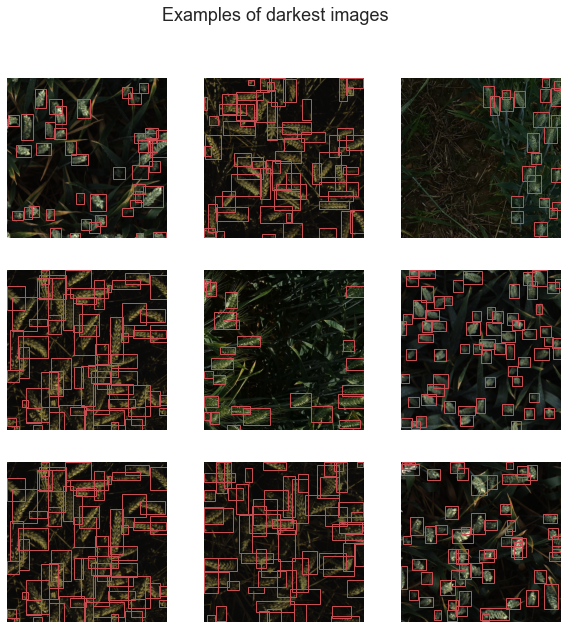

In [121]:
dark_ids = train_df[train_df['brightness'] < 30].image_name
plot_image_examples(train_df[train_df.image_name.isin(dark_ids)], title='Examples of darkest images')

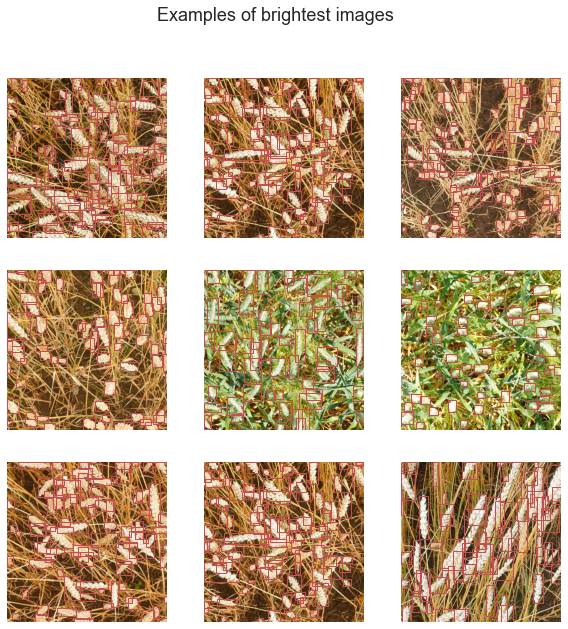

In [122]:
bright_ids = train_df[train_df['brightness'] > 130].image_name
plot_image_examples(train_df[train_df.image_name.isin(bright_ids)], title='Examples of brightest images')

### BGR channel intensities

In [123]:
def get_percentage_of_green_pixels(image):
    # convert to HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # get the green mask
    hsv_lower = (40, 40, 40) 
    hsv_higher = (70, 255, 255)
    green_mask = cv2.inRange(hsv, hsv_lower, hsv_higher)
    
    return float(np.sum(green_mask)) / 255 / (1024 * 1024)

def get_percentage_of_yellow_pixels(image):
    # convert to HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # get the green mask
    hsv_lower = (25, 40, 40) 
    hsv_higher = (35, 255, 255)
    yellow_mask = cv2.inRange(hsv, hsv_lower, hsv_higher)
    
    return float(np.sum(yellow_mask)) / 255 / (1024 * 1024)

In [124]:
def add_green_pixels_percentage(df):
    green = []
    for _, row in df.iterrows():
        img_id = row.image_name 
        image = cv2.imread(str(data_dir / img_id))
        green.append(get_percentage_of_green_pixels(image))
        
    green_df = pd.DataFrame(green)
    green_df.columns = ['green_pixels']
    df = pd.concat([df, green_df], ignore_index=True, axis=1)
    df.columns = ['image_name', 'green_pixels']
    
    return df

def add_yellow_pixels_percentage(df):
    yellow = []
    for _, row in df.iterrows():
        img_id = row.image_name  
        image = cv2.imread(str(data_dir / img_id))
        yellow.append(get_percentage_of_yellow_pixels(image))
        
    yellow_df = pd.DataFrame(yellow)
    yellow_df.columns = ['yellow_pixels']
    df = pd.concat([df, yellow_df], ignore_index=True, axis=1)
    df.columns = ['image_name', 'yellow_pixels']
    
    return df

In [125]:
train_df7 = train_df5.copy()

In [126]:
green_pixels_df = pd.DataFrame(train_df7.image_name.unique())
green_pixels_df.columns = ['image_name']

In [127]:
green_pixels_df = add_green_pixels_percentage(green_pixels_df)

In [128]:
green_pixels_df.head()

,image_name,green_pixels
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,0.609044
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,0.530778
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,0.599527
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,0.388277
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,0.518061


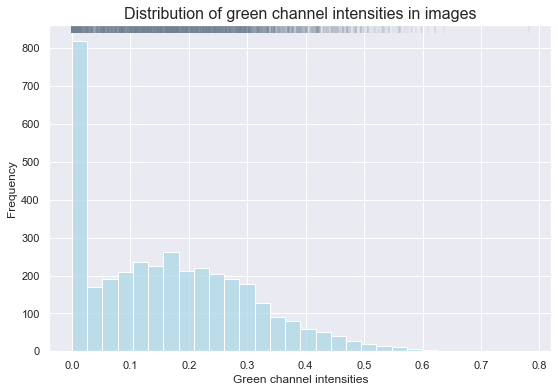

In [129]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
sns.histplot(data=green_pixels_df, x="green_pixels", color = 'lightblue', bins =30)
plt.title("Distribution of green channel intensities in images", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Green channel intensities')

upper_rugplot(green_pixels_df.green_pixels, ax=ax, alpha= 0.4, color= 'slategray', height = 0.025, linewidth=0.4)

plt.show()

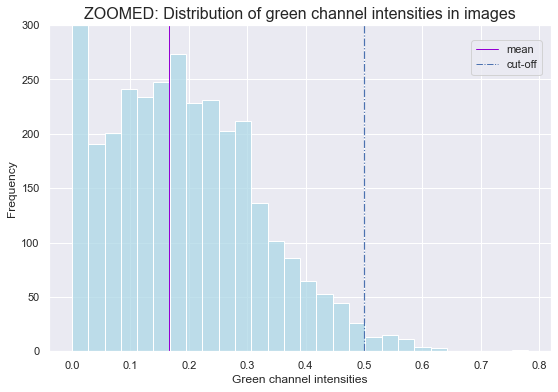

In [130]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
plt.ylim(0, 300)
sns.histplot(data=green_pixels_df, x="green_pixels", color = 'lightblue')
plt.title("ZOOMED: Distribution of green channel intensities in images", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Green channel intensities')

plt.axvline(x=0.5,linestyle='-.', linewidth=1.2)
plt.axvline(x=green_pixels_df.green_pixels.mean(), color = 'darkviolet', linewidth=1)
#legend_elements = leg_els
ax.legend(handles=leg_els, loc='upper left', bbox_to_anchor=(0.83,0.97))

plt.show()

In [131]:
train_df = train_df6.merge(green_pixels_df, on='image_name')

In [132]:
train_df.head()

,image_name,BoxesString,domain,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax,area,green_pixels
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[99, 692, 160, 764]",Arvalis_1,99.0,692.0,160.0,764.0,4392.0,0.609044
1,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[641, 27, 697, 115]",Arvalis_1,641.0,27.0,697.0,115.0,4928.0,0.609044
2,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[935, 978, 1012, 1020]",Arvalis_1,935.0,978.0,1012.0,1020.0,3234.0,0.609044
3,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[377, 834, 463, 890]",Arvalis_1,377.0,834.0,463.0,890.0,4816.0,0.609044
4,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,"[654, 797, 696, 837]",Arvalis_1,654.0,797.0,696.0,837.0,1680.0,0.609044


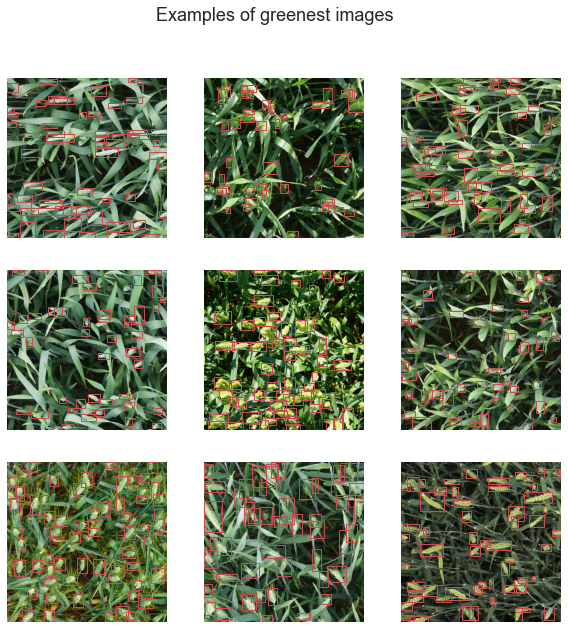

In [133]:
greenest_ids = green_pixels_df[green_pixels_df['green_pixels'] > 0.50].image_name
plot_image_examples(train_df[train_df.image_name.isin(greenest_ids)], title='Examples of greenest images')

In [134]:
#yellow_pixels_df.head()

In [135]:
# add a column with the percentage of green pixels
yellow_pixels_df = add_yellow_pixels_percentage(images_df)

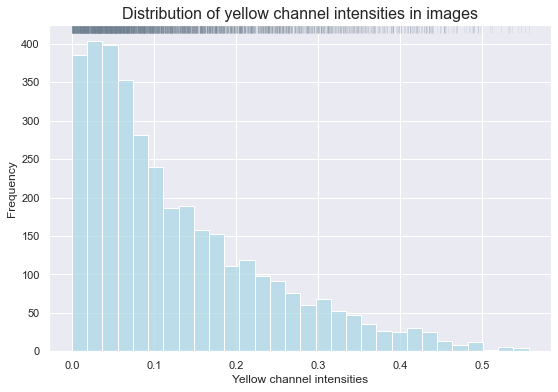

In [136]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
sns.histplot(data=yellow_pixels_df, x="yellow_pixels", color = 'lightblue', bins =30)
plt.title("Distribution of yellow channel intensities in images", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Yellow channel intensities')

upper_rugplot(yellow_pixels_df.yellow_pixels, ax=ax, alpha= 0.2, color= 'slategray', height = 0.025, linewidth=0.5)

plt.show()

#color= 'darkslategray'
#color= 'steelblue'
#color= 'darkslateblue'
#color= 'slategrey'
#color= 'dimgray'

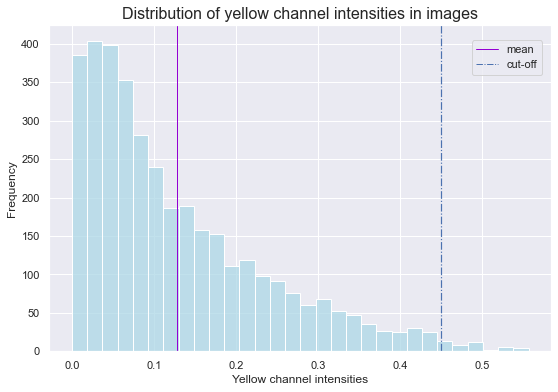

In [137]:
# Density Plot with Rug Plot
sns.set(rc={'figure.figsize':(9, 6)})
fig, ax = plt.subplots()
sns.histplot(data=yellow_pixels_df, x="yellow_pixels", color = 'lightblue', bins =30)
plt.title("Distribution of yellow channel intensities in images", fontsize=16)
plt.ylabel('Frequency')
plt.xlabel('Yellow channel intensities')

plt.axvline(x=yellow_pixels_df.yellow_pixels.mean(), color = 'darkviolet', linewidth=1)
plt.axvline(x=0.45,linestyle='-.', linewidth=1.2)

#legend_elements = leg_els

ax.legend(handles=leg_els, loc='upper left', bbox_to_anchor=(0.83,0.97))

plt.show()

In [138]:
train_df = train_df.merge(yellow_pixels_df, on='image_name')

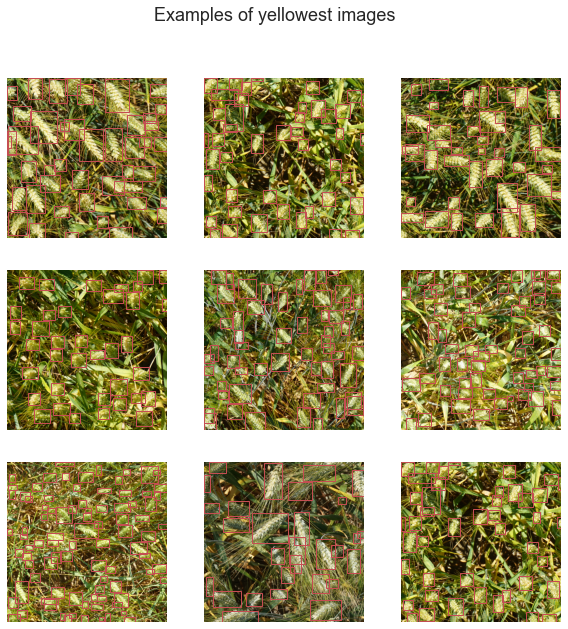

In [139]:
yellowest_ids = yellow_pixels_df[yellow_pixels_df['yellow_pixels'] > 0.45].image_name
plot_image_examples(train_df[train_df.image_name.isin(yellowest_ids)], title='Examples of yellowest images')
#len(yellowest_ids)

### Wheat counts vs other variables
Let's further explore the wheat head counts per image.

In [140]:
train_count.head()

,image_name,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax,bbox_count
0,0007634580386bd39d4d0d24df58893c3bb967e12d6fc0...,22215.0,19188.0,28532.0,25230.0,47
1,00417fc37a35f14ce3044bf2ae6c76d19bf42a426a9403...,16841.0,15744.0,20006.0,18905.0,37
2,004b381a051838dc0cc8ff293e09823faa1dd6f26e82ff...,29883.0,28356.0,33617.0,32855.0,59
3,004ccec5da561b85d8b05ed11c071ac9ef3af5c8c9a1d6...,18726.0,19818.0,22338.0,23766.0,43
4,006f18cc577457d0d0b987d1af19e5568541cc5f84e143...,41054.0,37345.0,45453.0,42030.0,83


In [141]:
domain_df = train_df.iloc[:, :3].drop('BoxesString', axis = 1)

In [142]:
domain_df.head()

,image_name,domain
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
1,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
2,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
3,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
4,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1


In [143]:
train_corr = yellow_pixels_df.merge(green_pixels_df, on='image_name').merge(train_count, on='image_name').merge(domain_df, on='image_name').merge(brightness_df, on = 'image_name')

In [144]:
train_corr.head()

,image_name,yellow_pixels,green_pixels,bbox_xmin,bbox_ymin,bbox_xmax,bbox_ymax,bbox_count,domain,brightness
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,0.030209,0.609044,20534.0,19894.0,23608.0,22130.0,41,Arvalis_1,85.802637
1,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,0.030209,0.609044,20534.0,19894.0,23608.0,22130.0,41,Arvalis_1,85.802637
2,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,0.030209,0.609044,20534.0,19894.0,23608.0,22130.0,41,Arvalis_1,85.802637
3,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,0.030209,0.609044,20534.0,19894.0,23608.0,22130.0,41,Arvalis_1,85.802637
4,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,0.030209,0.609044,20534.0,19894.0,23608.0,22130.0,41,Arvalis_1,85.802637


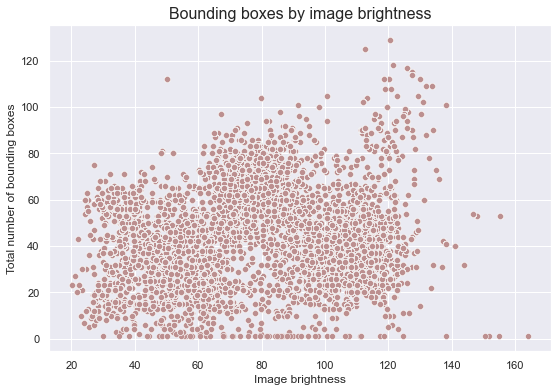

In [145]:
sns.scatterplot(data=train_corr, x="brightness", y="bbox_count", color='rosybrown')
plt.title("Bounding boxes by image brightness", fontsize=16)
plt.xlabel('Image brightness')
plt.ylabel('Total number of bounding boxes')
plt.show()

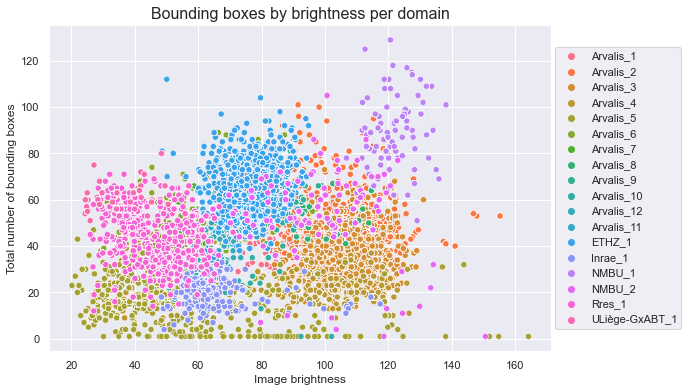

In [146]:
sns.scatterplot(data=train_corr, x="brightness", y="bbox_count", hue ='domain')
plt.title("Bounding boxes by brightness per domain", fontsize=16)
plt.xlabel('Image brightness')
plt.ylabel('Total number of bounding boxes')
plt.legend(bbox_to_anchor=(1.27,.95))
plt.show()

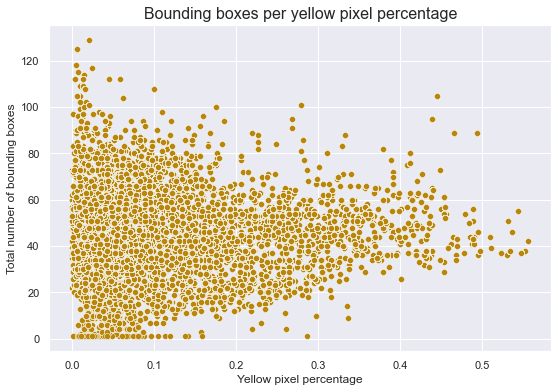

In [147]:
sns.scatterplot(data=train_corr, x="yellow_pixels", y="bbox_count", color='darkgoldenrod')
plt.title("Bounding boxes per yellow pixel percentage", fontsize=16)
plt.xlabel('Yellow pixel percentage')
plt.ylabel('Total number of bounding boxes')
plt.show()

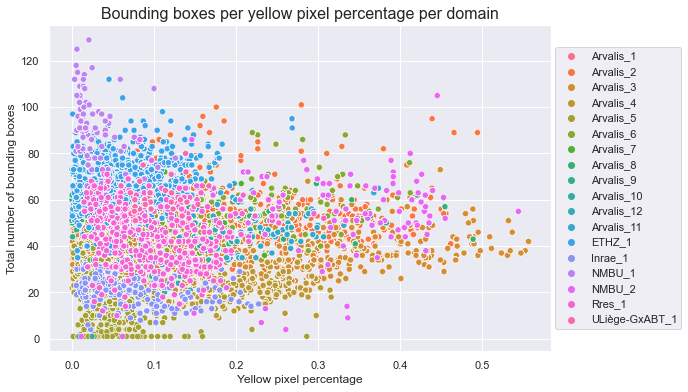

In [148]:
sns.scatterplot(data=train_corr, x="yellow_pixels", y="bbox_count", hue ='domain')
plt.title("Bounding boxes per yellow pixel percentage per domain", fontsize=16)
plt.xlabel('Yellow pixel percentage')
plt.ylabel('Total number of bounding boxes')
plt.legend(bbox_to_anchor=(1.27,.95))
plt.show()

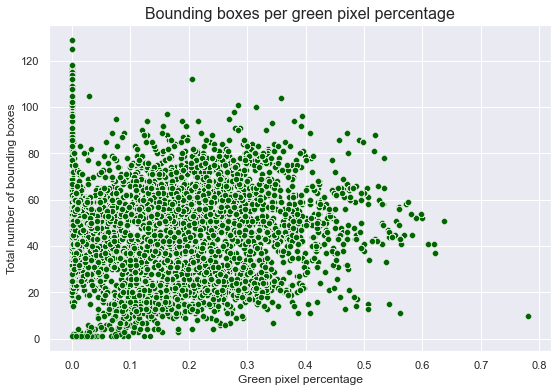

In [149]:
sns.scatterplot(data=train_corr, x="green_pixels", y="bbox_count", color='darkgreen')
plt.title("Bounding boxes per green pixel percentage", fontsize=16)
plt.xlabel('Green pixel percentage')
plt.ylabel('Total number of bounding boxes')
plt.show()

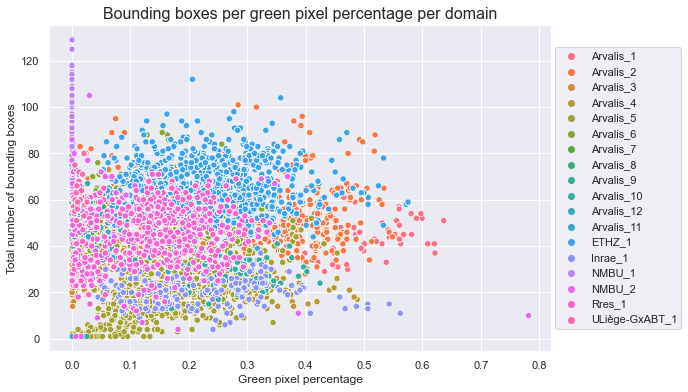

In [150]:
sns.scatterplot(data=train_corr, x="green_pixels", y="bbox_count", hue='domain')
plt.title("Bounding boxes per green pixel percentage per domain", fontsize=16)
plt.xlabel('Green pixel percentage')
plt.ylabel('Total number of bounding boxes')
plt.legend(bbox_to_anchor=(1.27,.95))
plt.show()

In [151]:
NMBU1_green=set(train_corr[train_corr['domain']=='NMBU_1'].green_pixels)

In [152]:
NMBU1_green

{0.0,
 9.5367431640625e-07,
 1.9073486328125e-06,
 2.86102294921875e-06,
 3.814697265625e-06,
 5.7220458984375e-06,
 7.62939453125e-06,
 8.58306884765625e-06,
 9.5367431640625e-06,
 1.239776611328125e-05,
 1.430511474609375e-05,
 1.52587890625e-05,
 1.811981201171875e-05,
 2.002716064453125e-05,
 2.288818359375e-05,
 2.384185791015625e-05,
 2.47955322265625e-05,
 2.765655517578125e-05,
 2.86102294921875e-05,
 3.24249267578125e-05,
 3.337860107421875e-05,
 3.910064697265625e-05,
 4.100799560546875e-05,
 4.38690185546875e-05,
 4.482269287109375e-05,
 4.863739013671875e-05,
 4.9591064453125e-05,
 6.866455078125e-05,
 7.343292236328125e-05,
 7.915496826171875e-05,
 8.392333984375e-05,
 8.7738037109375e-05,
 0.00010395050048828125,
 0.00010585784912109375,
 0.00014591217041015625,
 0.0001544952392578125,
 0.00018787384033203125,
 0.00025844573974609375,
 0.00028228759765625,
 0.00030422210693359375,
 0.00043964385986328125,
 0.000675201416015625,
 0.00116729736328125,
 0.0015811920166015625

Clearly, the wheat images from domain `NMBU_1` have very low green pixel intensity, as demonstrated first from the "Bounding boxes per green pixel percentage per domain" scatterplot, as finally by printing the set of green pixel percentage values for images from `NMBU_1`.

### Brightness and color intensities: mean and standard deviation per image

Because the original brightness measurement of each image was the mean of the brightness of each pixel, (for brightness) I only need to define functions to find the standard deviation of the brightness of each image (and add to the brightness dataframe). For green and yellow pixel intensities, however, I will need to define new functions to calculate both mean and standard deviations, as well as functions to add these values to the dataframes.

In [153]:
def get_std_brightness(image):
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # get average brightness
    return np.array(gray).std()

In [154]:
def add_std_brightness_column(df):
    brightness_std = []
    for _, row in df.iterrows():
        img_id = row.image_name
        image = cv2.imread(str(data_dir / img_id))
        brightness_std.append(get_std_brightness(image))

    brightness_std_df = pd.DataFrame(brightness_std)
    brightness_std_df.columns = ['brightness_std']
    df = pd.concat([df, brightness_std_df], ignore_index=True, axis=1)
    df.columns = ['image_name', 'brightness_std']

    return df

In [155]:
brightness_df.head()

,image_name,brightness
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,85.802637
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,91.932296
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,85.085322
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,83.631724
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,87.268487


In [156]:
brightness_std_df = add_std_brightness_column(images_df)

In [157]:
brightness_std_df.head()

,image_name,brightness_std
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,58.023168
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,58.538550
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,64.482757
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,63.299550
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,58.979921


In [158]:
brightness_stats_df = brightness_std_df.merge(brightness_df, on="image_name")

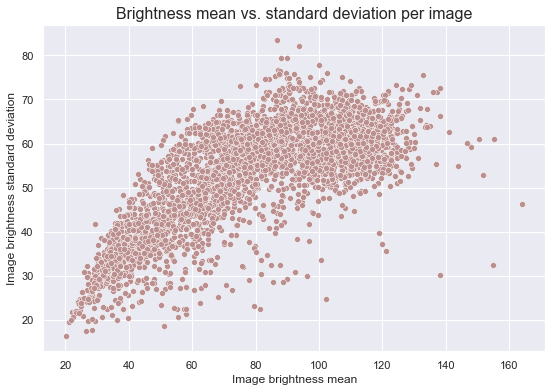

In [159]:
sns.scatterplot(data=brightness_stats_df, x="brightness", y="brightness_std", color='rosybrown')
plt.title("Brightness mean vs. standard deviation per image", fontsize=16)
plt.xlabel('Image brightness mean')
plt.ylabel('Image brightness standard deviation')
plt.show()

In [160]:
brightness_stats_df = brightness_stats_df.merge(domain_df, how='right', 
                                on='image_name').drop_duplicates().reset_index(drop=True)

In [161]:
brightness_stats_df.head()

,image_name,brightness_std,brightness,domain
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,58.023168,85.802637,Arvalis_1
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,58.538550,91.932296,Arvalis_1
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,64.482757,85.085322,Arvalis_1
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,63.299550,83.631724,Arvalis_1
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,58.979921,87.268487,Arvalis_1


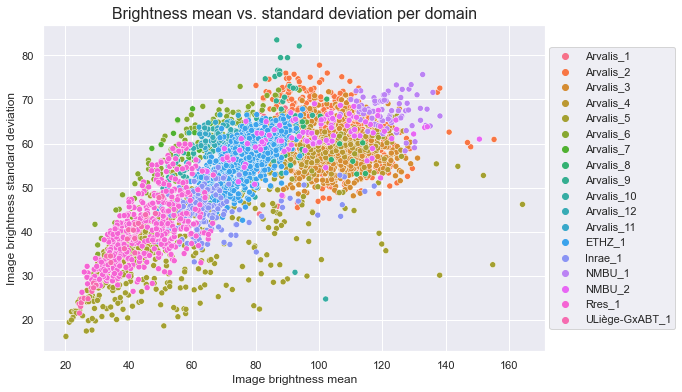

In [162]:
sns.scatterplot(data=brightness_stats_df, x="brightness", y="brightness_std", hue='domain')
plt.title("Brightness mean vs. standard deviation per domain", fontsize=16)
plt.xlabel('Image brightness mean')
plt.ylabel('Image brightness standard deviation')
plt.legend(bbox_to_anchor=(1.27,.95))
plt.show()

### Color channel intensity statistics

In [163]:
def get_mean_of_BGR_channel(image, channel_num):
    channel_values = image[:,:,int(channel_num)]
    return float(np.mean(channel_values))

In [164]:
def add_mean_channel_column(df, channel_num, column_name):
    channel = []
    for _, row in df.iterrows():
        img_id = row.image_name
        image = cv2.imread(str(data_dir / img_id))
        channel.append(get_mean_of_BGR_channel(image, channel_num))

    channel_df = pd.DataFrame(channel)
    channel_df.columns = [str(column_name)]
    df = pd.concat([df, channel_df], ignore_index=True, axis=1)
    df.columns = ['image_name', str(column_name)]

    return df

In [165]:
def get_std_of_BGR_channel(image, channel_num):
    channel_values = image[:,:,int(channel_num)]
    return float(np.std(channel_values))

In [166]:
def add_std_channel_column(df, channel_num, column_name):
    channel = []
    for _, row in df.iterrows():
        img_id = row.image_name
        image = cv2.imread(str(data_dir / img_id))
        channel.append(get_std_of_BGR_channel(image, channel_num))

    channel_df = pd.DataFrame(channel)
    channel_df.columns = [str(column_name)]
    df = pd.concat([df, channel_df], ignore_index=True, axis=1)
    df.columns = ['image_name', str(column_name)]

    return df

### Blue channel intensities

In [170]:
blue_pixel_mean_df = add_mean_channel_column(df=images_df, channel_num=0 , 
                                             column_name='blue_pixel_mean')

In [175]:
blue_pixel_std_df = add_std_channel_column(df=images_df, channel_num=0 , 
                                            column_name='blue_pixel_std')

In [176]:
blue_pixel_stats_df = blue_pixel_mean_df.merge(blue_pixel_std_df, on='image_name')

In [177]:
blue_pixel_stats_df.head()

,image_name,blue_pixel_mean,blue_pixel_std
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,62.784842,49.141549
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,76.015515,59.166369
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,56.810772,53.592730
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,70.208336,60.728616
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,70.376910,54.225080


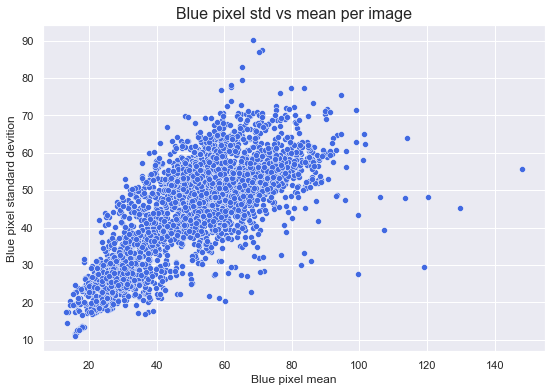

In [178]:
sns.scatterplot(data=blue_pixel_stats_df, x="blue_pixel_mean", y="blue_pixel_std", 
                color='royalblue')
plt.title("Blue pixel std vs mean per image", fontsize=16)
plt.xlabel('Blue pixel mean')
plt.ylabel('Blue pixel standard devition')
plt.show()

In [248]:
blue_pixel_stats_df = blue_pixel_stats_df.merge(domain_df, how='right', 
                                on='image_name').drop_duplicates().reset_index(drop=True)

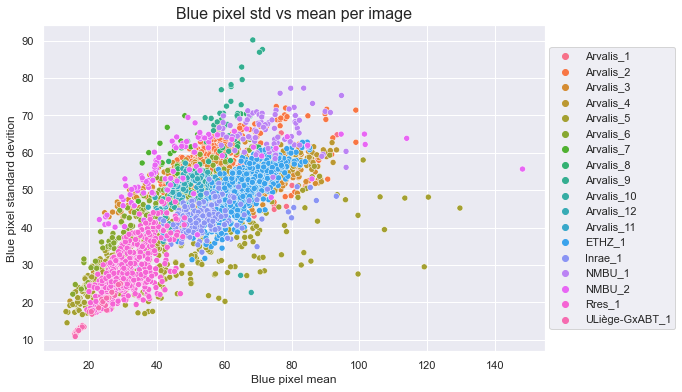

In [180]:
sns.scatterplot(data=blue_pixel_stats_df, x="blue_pixel_mean", y="blue_pixel_std", 
                hue='domain')
plt.title("Blue pixel std vs mean per image", fontsize=16)
plt.xlabel('Blue pixel mean')
plt.ylabel('Blue pixel standard devition')
plt.legend(bbox_to_anchor=(1.27,.95))
plt.show()

### Green channel intensities

In [181]:
green_pixel_mean_df = add_mean_channel_column(df=images_df, channel_num=1, 
                                              column_name='green_pixel_mean')

In [182]:
green_pixel_std_df = add_std_channel_column(df=images_df, channel_num=1, 
                                             column_name='green_pixel_std')

In [183]:
green_pixel_stats_df = green_pixel_mean_df.merge(green_pixel_std_df, on='image_name')

In [184]:
green_pixel_stats_df.head()

,image_name,green_pixel_mean,green_pixel_std
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,96.742218,62.804630
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,101.579394,61.233402
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,97.285945,68.200341
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,93.034210,66.715689
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,96.760343,62.196945


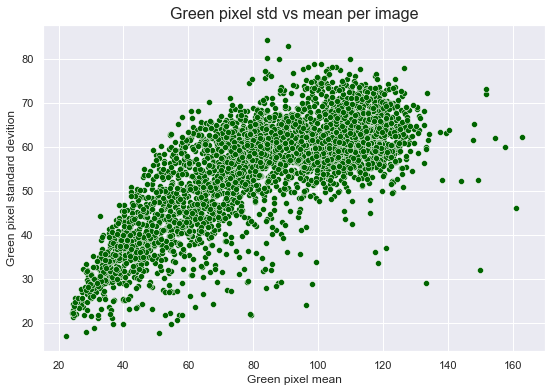

In [185]:
sns.scatterplot(data=green_pixel_stats_df, x="green_pixel_mean", y="green_pixel_std", 
                color='darkgreen')
plt.title("Green pixel std vs mean per image", fontsize=16)
plt.xlabel('Green pixel mean')
plt.ylabel('Green pixel standard devition')
plt.show()

In [186]:
green_pixel_stats_df = green_pixel_stats_df.merge(domain_df, how='right', 
                                on='image_name').drop_duplicates().reset_index(drop=True)

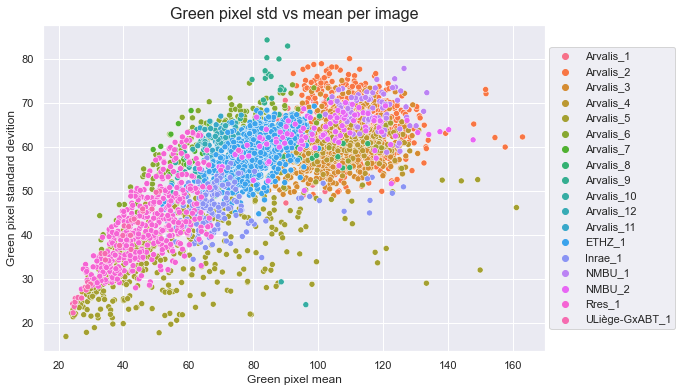

In [187]:
sns.scatterplot(data=green_pixel_stats_df, x="green_pixel_mean", y="green_pixel_std", 
                hue='domain')
plt.title("Green pixel std vs mean per image", fontsize=16)
plt.xlabel('Green pixel mean')
plt.ylabel('Green pixel standard devition')
plt.legend(bbox_to_anchor=(1.27,.95))
plt.show()

### Red channel intensities

In [188]:
red_pixel_mean_df = add_mean_channel_column(df=images_df, channel_num=2, 
                                              column_name='red_pixel_mean')

In [189]:
red_pixel_std_df = add_std_channel_column(df=images_df, channel_num=1, 
                                             column_name='red_pixel_std')

In [190]:
red_pixel_stats_df = red_pixel_mean_df.merge(red_pixel_std_df, on='image_name')

In [191]:
red_pixel_stats_df.head()

,image_name,red_pixel_mean,red_pixel_std
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,73.103398,62.804630
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,79.054649,61.233402
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,71.912717,68.200341
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,70.279390,66.715689
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,75.075441,62.196945


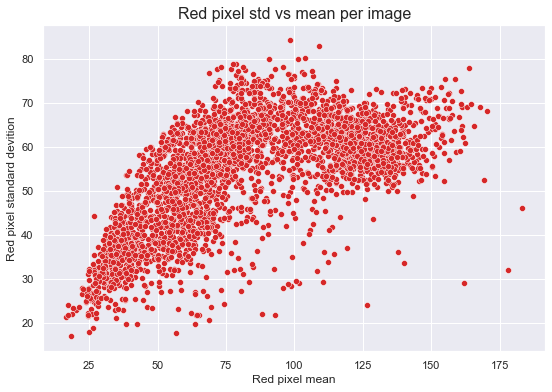

In [192]:
sns.scatterplot(data=red_pixel_stats_df, x="red_pixel_mean", y="red_pixel_std", 
                color='tab:red')
plt.title("Red pixel std vs mean per image", fontsize=16)
plt.xlabel('Red pixel mean')
plt.ylabel('Red pixel standard devition')
plt.show()

In [193]:
red_pixel_stats_df = red_pixel_stats_df.merge(domain_df, how='right', 
                                on='image_name').drop_duplicates().reset_index(drop=True)

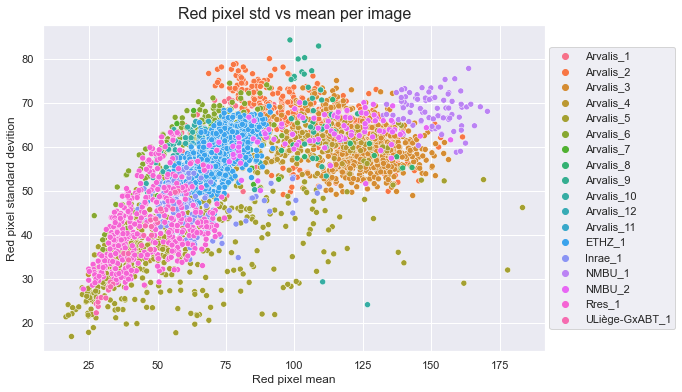

In [194]:
sns.scatterplot(data=red_pixel_stats_df, x="red_pixel_mean", y="red_pixel_std", 
                hue='domain')
plt.title("Red pixel std vs mean per image", fontsize=16)
plt.xlabel('Red pixel mean')
plt.ylabel('Red pixel standard devition')
plt.legend(bbox_to_anchor=(1.27,.95))
plt.show()

### Mean images per domain

Now let's take a look at the **average (mean) image** from **each domain**.

In [195]:
mean_domain_df = domain_df.drop_duplicates().reset_index(drop=True)

In [196]:
mean_domain_df.head()

,image_name,domain
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,Arvalis_1
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,Arvalis_1
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,Arvalis_1
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,Arvalis_1


For the next few steps, we will work directly with the pixel values of each image so we can do operations on them. We can accomplish this by converting our images into a Numpy array.

In [197]:
# making n X m matrix
def img2np(df, size = (64, 64)):
    # iterating through each file
    for _, row in df.iterrows():
        img_id = row.image_name
        current_image = cv2.cvtColor(cv2.imread(str(data_dir / img_id)), cv2.COLOR_BGR2GRAY)

        # covert image to a matrix
        img_ts = np.squeeze(np.array(current_image))
        # turn that into a vector / 1D array
        img_ts = [img_ts.ravel()]
        try:
            # concatenate different images
            full_mat = np.concatenate((full_mat, img_ts))
        except UnboundLocalError: 
            # if not assigned yet, assign one
            full_mat = img_ts
    return full_mat

# run it on our folders
#normal_images = img2np(f'{train_dir}/NORMAL/', normal_imgs)
#pnemonia_images = img2np(f'{train_dir}/PNEUMONIA/', pneumo_imgs)

In [198]:
def find_mean_img(full_mat, title, size = (1024, 1024)):
    # calculate the average
    mean_img = np.mean(full_mat, axis = 0)
    # reshape it back to a matrix
    mean_img = mean_img.reshape(size)
    plt.imshow(mean_img, vmin=0, vmax=255, cmap='Greys_r')
    plt.title(f'{title}')
    plt.axis('off')
    plt.show()
    return mean_img

# norm_mean = find_mean_img(normal_images, 'NORMAL')
# pneu_mean = find_mean_img(pnemonia_images, 'PNEUMONIA')

In [199]:
new_domain_df = images_df.merge(domain_df, how='inner', on='image_name').drop_duplicates().reset_index(drop=True)

In [200]:
new_domain_df

,image_name,domain
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,Arvalis_1
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,Arvalis_1
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,Arvalis_1
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,Arvalis_1
...,...,...
3652,aa8967fdf620ab4d7b6ff75531ad37cf16a5f5deca131d...,ULiège-GxABT_1
3653,4bfbbdac0fd5c16db471aa3dcfa20e6b2bbd60230b1969...,ULiège-GxABT_1
3654,cd4a7c09f3b6832278f24d30b9143718dfde8998f2da78...,ULiège-GxABT_1
3655,3362115207dbd2b1e28cb22b14eb910a0cb1068c7e47b7...,ULiège-GxABT_1


In [201]:
domain_df.head()

,image_name,domain
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
1,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
2,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
3,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
4,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1


In [202]:
Arvalis_1_df = new_domain_df[new_domain_df['domain']=='Arvalis_1']

In [203]:
Arvalis_1_df

,image_name,domain
0,4563856cc6d75c670eafd86d5eb7245fbe8f273c28f9e3...,Arvalis_1
1,a2a15938845d9812de03bd44799c4b1bf856a8ad11752e...,Arvalis_1
2,401f89a2bb6ab63e3f406bd59b9cadccfe953230feb6cd...,Arvalis_1
3,0a3937653483c36dfb4d957b6f82ae96dbdc7ba36cc3d8...,Arvalis_1
4,be1652110a44acd24b42784356e965ce84a04893c3f1bb...,Arvalis_1
...,...,...
61,e1e8b538f3aee8a5e78c067c4561f30015ac6a25854e4f...,Arvalis_1
62,cdadbd6956e34e27ba215da4e7752f21ee937466d1a836...,Arvalis_1
63,85910c268f249c07de3ac217e2e9b77216764eebf2ae42...,Arvalis_1
64,dfe58d49d025cd05477e83f75514ae2a1429e91f8610a6...,Arvalis_1


In [204]:
new_domain_df.domain.unique()

array(['Arvalis_1', 'Arvalis_2', 'Arvalis_3', 'Arvalis_4', 'Arvalis_5',
       'Arvalis_6', 'Arvalis_7', 'Arvalis_8', 'Arvalis_9', 'Arvalis_10',
       'Arvalis_12', 'Arvalis_11', 'ETHZ_1', 'Inrae_1', 'NMBU_1',
       'NMBU_2', 'Rres_1', 'ULiège-GxABT_1'], dtype=object)

In [205]:
Arvalis_2_df = new_domain_df[new_domain_df['domain']=='Arvalis_2']
Arvalis_3_df = new_domain_df[new_domain_df['domain']=='Arvalis_3']
Arvalis_4_df = new_domain_df[new_domain_df['domain']=='Arvalis_4']
Arvalis_5_df = new_domain_df[new_domain_df['domain']=='Arvalis_5']
Arvalis_6_df = new_domain_df[new_domain_df['domain']=='Arvalis_6']
Arvalis_7_df = new_domain_df[new_domain_df['domain']=='Arvalis_7']
Arvalis_8_df = new_domain_df[new_domain_df['domain']=='Arvalis_8']
Arvalis_9_df = new_domain_df[new_domain_df['domain']=='Arvalis_9']
Arvalis_10_df = new_domain_df[new_domain_df['domain']=='Arvalis_10']
Arvalis_11_df = new_domain_df[new_domain_df['domain']=='Arvalis_11']
Arvalis_12_df = new_domain_df[new_domain_df['domain']=='Arvalis_12']
ETHZ_1_df = new_domain_df[new_domain_df['domain']=='ETHZ_1']
Inrae_1_df = new_domain_df[new_domain_df['domain']=='Inrae_1']
NMBU_1_df = new_domain_df[new_domain_df['domain']=='NMBU_1']
NMBU_2_df = new_domain_df[new_domain_df['domain']=='NMBU_2']
Rres_1_df = new_domain_df[new_domain_df['domain']=='Rres_1']
ULiège_GxABT_1_df = new_domain_df[new_domain_df['domain']=='ULiège-GxABT_1']

In [206]:
Arvalis_1_array = img2np(Arvalis_1_df)

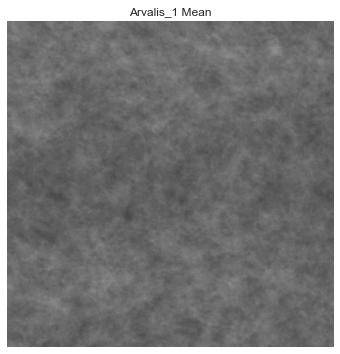

In [207]:
Arvalis_1_mean = find_mean_img(Arvalis_1_array, 'Arvalis_1 Mean')

In [208]:
Arvalis_2_array = img2np(Arvalis_2_df)

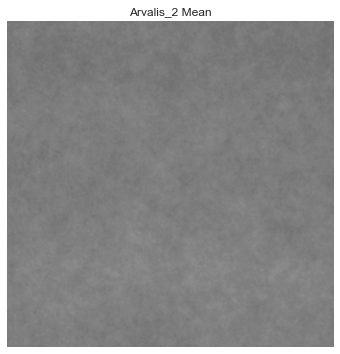

In [209]:
Arvalis_2_mean = find_mean_img(Arvalis_2_array, 'Arvalis_2 Mean')

In [210]:
Arvalis_3_array = img2np(Arvalis_3_df)

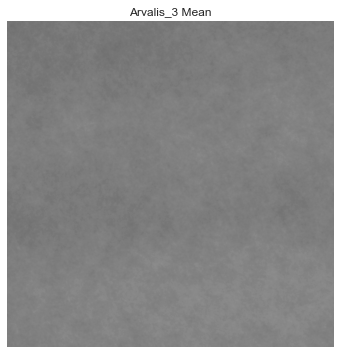

In [211]:
Arvalis_3_mean = find_mean_img(Arvalis_3_array, 'Arvalis_3 Mean')

In [212]:
Arvalis_4_array = img2np(Arvalis_4_df)

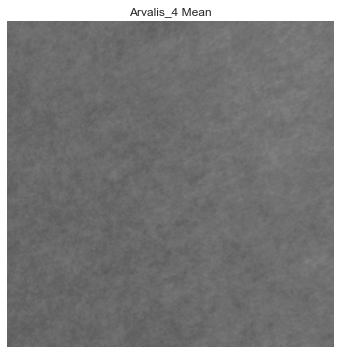

In [213]:
Arvalis_4_mean = find_mean_img(Arvalis_4_array, 'Arvalis_4 Mean')

In [214]:
Arvalis_5_array = img2np(Arvalis_5_df)

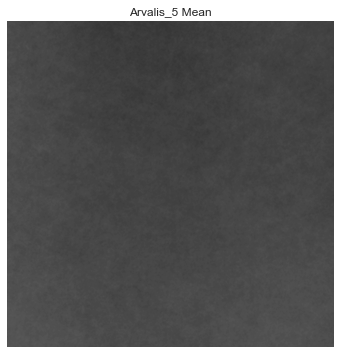

In [215]:
Arvalis_5_mean = find_mean_img(Arvalis_5_array, 'Arvalis_5 Mean')

In [216]:
Arvalis_6_array = img2np(Arvalis_6_df)

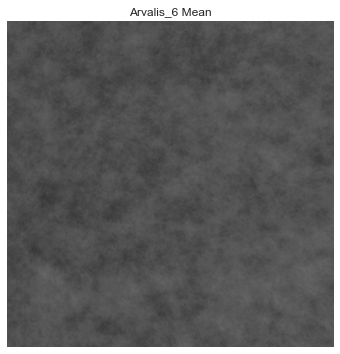

In [217]:
Arvalis_6_mean = find_mean_img(Arvalis_6_array, 'Arvalis_6 Mean')

In [218]:
Arvalis_7_array = img2np(Arvalis_7_df)

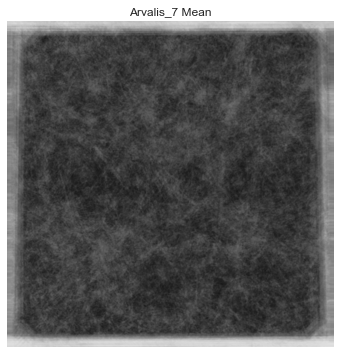

In [219]:
Arvalis_7_mean = find_mean_img(Arvalis_7_array, 'Arvalis_7 Mean')

In [220]:
Arvalis_8_array = img2np(Arvalis_8_df)

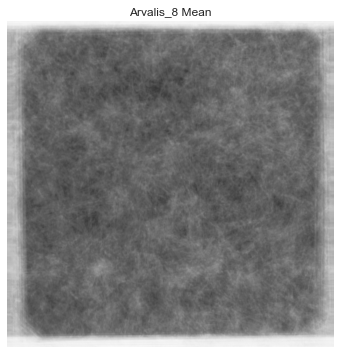

In [221]:
Arvalis_8_mean = find_mean_img(Arvalis_8_array, 'Arvalis_8 Mean')

In [222]:
Arvalis_9_array = img2np(Arvalis_9_df)

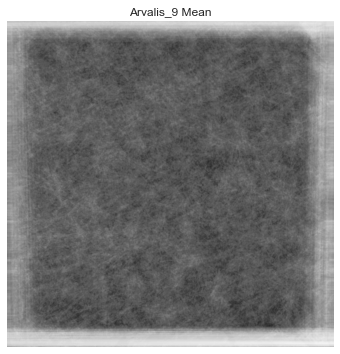

In [223]:
Arvalis_9_mean = find_mean_img(Arvalis_9_array, 'Arvalis_9 Mean')

In [224]:
Arvalis_10_array = img2np(Arvalis_10_df)

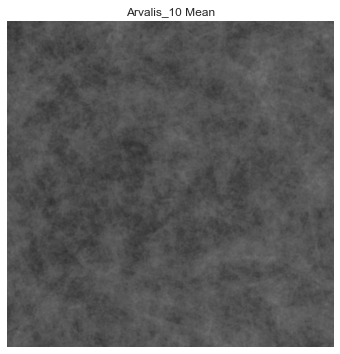

In [225]:
Arvalis_10_mean = find_mean_img(Arvalis_10_array, 'Arvalis_10 Mean')

In [226]:
Arvalis_11_array = img2np(Arvalis_11_df)

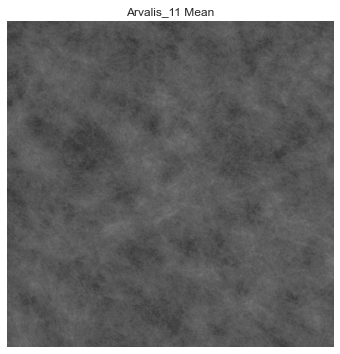

In [227]:
Arvalis_11_mean = find_mean_img(Arvalis_11_array, 'Arvalis_11 Mean')

In [228]:
Arvalis_12_array = img2np(Arvalis_12_df)

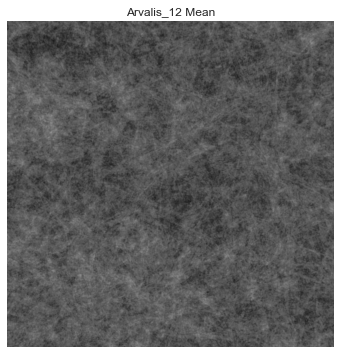

In [229]:
Arvalis_12_mean = find_mean_img(Arvalis_12_array, 'Arvalis_12 Mean')

In [230]:
ETHZ_1_array = img2np(ETHZ_1_df)

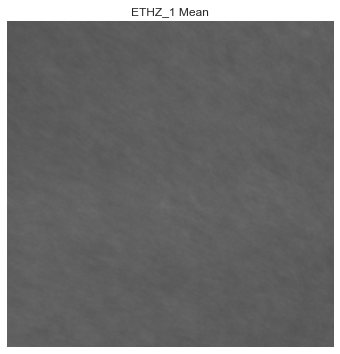

In [231]:
ETHZ_1_mean = find_mean_img(ETHZ_1_array, 'ETHZ_1 Mean')

In [232]:
Inrae_1_array = img2np(Inrae_1_df)

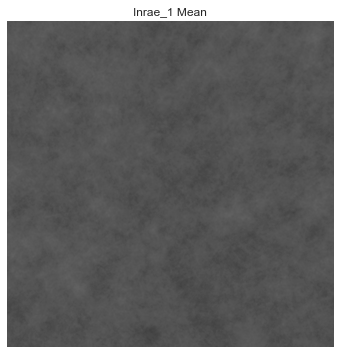

In [233]:
Inrae_1_mean = find_mean_img(Inrae_1_array, 'Inrae_1 Mean')

In [234]:
NMBU_1_array = img2np(NMBU_1_df)

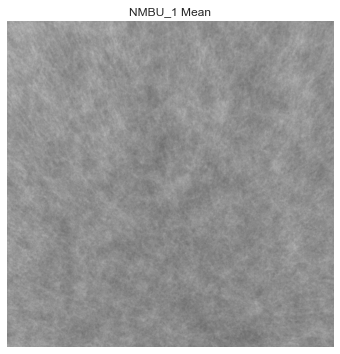

In [235]:
NMBU_1_mean = find_mean_img(NMBU_1_array, 'NMBU_1 Mean')

In [236]:
NMBU_2_array = img2np(NMBU_2_df)

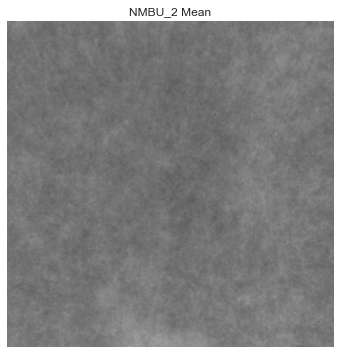

In [237]:
NMBU_2_mean = find_mean_img(NMBU_2_array, 'NMBU_2 Mean')

In [238]:
Rres_1_array = img2np(Rres_1_df)

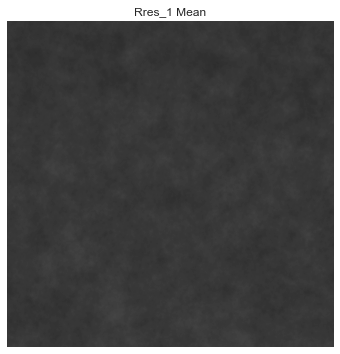

In [239]:
Rres_1_mean = find_mean_img(Rres_1_array, 'Rres_1 Mean')

In [240]:
ULiège_GxABT_1_df_array = img2np(ULiège_GxABT_1_df)

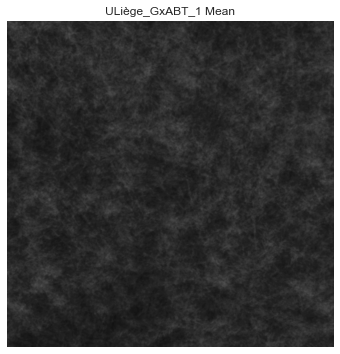

In [241]:
ULiège_GxABT_1_mean = find_mean_img(ULiège_GxABT_1_df_array, 'ULiège_GxABT_1 Mean')

In [242]:
mean_images_per_domain = [Arvalis_1_mean, Arvalis_2_mean, Arvalis_3_mean, Arvalis_4_mean, Arvalis_5_mean, 
                          Arvalis_6_mean, Arvalis_7_mean, Arvalis_8_mean, Arvalis_9_mean, Arvalis_10_mean,
                          Arvalis_11_mean, Arvalis_12_mean, ETHZ_1_mean, Inrae_1_mean, NMBU_1_mean, NMBU_2_mean,
                          Rres_1_mean, ULiège_GxABT_1_mean]

In [243]:
mean_images_names = ['Arvalis_1_mean', 'Arvalis_2_mean', 'Arvalis_3_mean', 'Arvalis_4_mean', 'Arvalis_5_mean', 
                     'Arvalis_6_mean', 'Arvalis_7_mean', 'Arvalis_8_mean', 'Arvalis_9_mean', 'Arvalis_10_mean',
                     'Arvalis_11_mean', 'Arvalis_12_mean', 'ETHZ_1_mean', 'Inrae_1_mean', 'NMBU_1_mean', 'NMBU_2_mean',
                     'Rres_1_mean', 'ULiège_GxABT_1_mean']

In [244]:
domain_images_dfs = [Arvalis_1_df, Arvalis_2_df, Arvalis_3_df, Arvalis_4_df, 
                      Arvalis_5_df, Arvalis_6_df, Arvalis_7_df, Arvalis_8_df, 
                      Arvalis_9_df, Arvalis_10_df, Arvalis_11_df, Arvalis_12_df, 
                      ETHZ_1_df, Inrae_1_df, NMBU_1_df, NMBU_2_df, Rres_1_df, 
                      ULiège_GxABT_1_df]

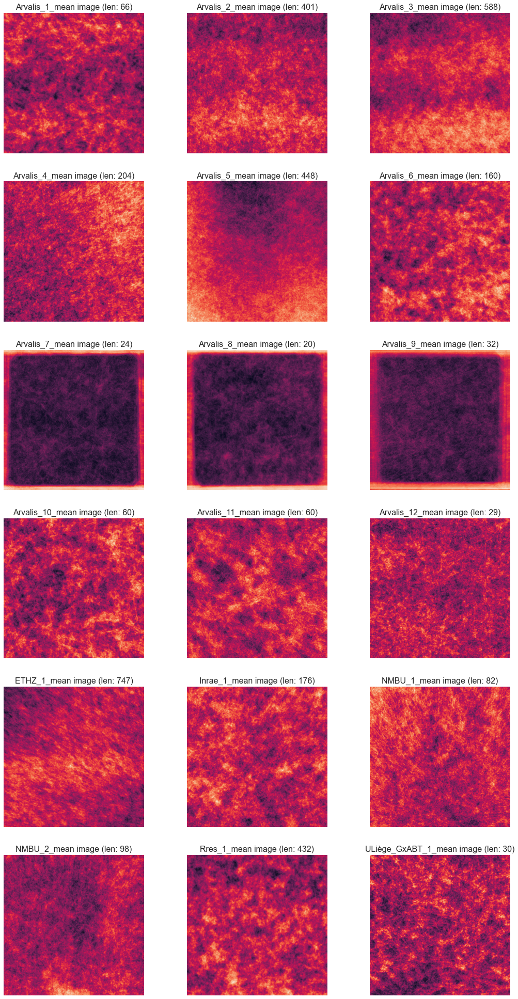

In [245]:
fig, axs = plt.subplots(6, 3, figsize=(18,35))
current_indx= 0
for row in range(6):
    for col in range(3):
        axs[row, col].axis('off')
        axs[row, col].imshow(mean_images_per_domain[current_indx])
        current_indx +=1
current_indx= 0
for row in range(6):
    for col in range(3):
        axs[row,col].set_title(mean_images_names[current_indx]+ ' image (len: ' + str(len(domain_images_dfs[current_indx])) +')', 
                               fontsize=16)
        current_indx +=1

## Histograms of Oriented Gradients (HOGs)

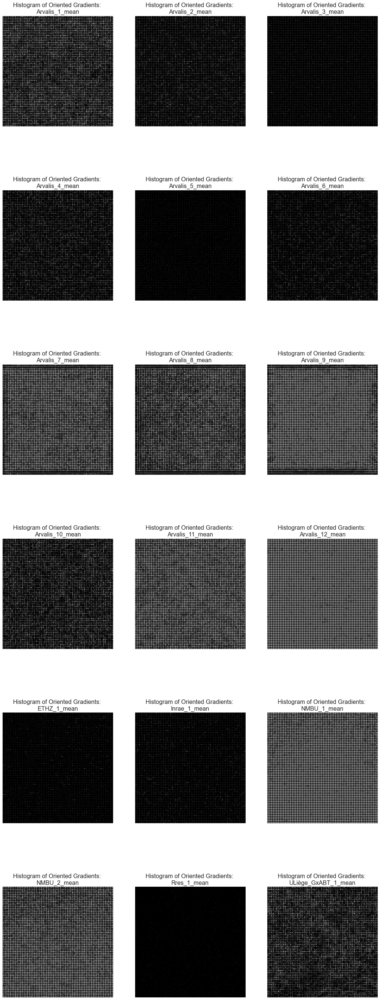

In [247]:
fig, axs = plt.subplots(6, 3, figsize=(18,50))
current_indx = 0
for row in range(6):
    for col in range(3):
        axs[row, col].axis('off')
        fd_abc, hog_abc= hog(mean_images_per_domain[current_indx], orientations=8, 
                             pixels_per_cell=(16, 16),cells_per_block=(1, 1), 
                             visualize=True)
        hog_image_rescaled = exposure.rescale_intensity(hog_abc, in_range=(0, .4))
        hog_image_rescaled = hog_image_rescaled.astype('uint8')
        axs[row, col].imshow(hog_image_rescaled, cmap=plt.cm.gray)
        axs[row,col].set_title('Histogram of Oriented Gradients: \n'+mean_images_names[current_indx], 
                               fontsize=16)
        current_indx += 1
plt.show()

### Save the datasets and images

Below, we save a csv copy of the data we'll most likely need for future steps in this project:

In [ ]:
# train_df3.to_csv('transformed_data/train_df.csv')

Let's also save two more csvs- the first with a full set of all of the data calculated in this notebook (besides the brightness and pixel stats) and a second with just brightness and pixel stats (just in *case* we want to use it later (and so we don't have to repeat calculations).

The `train_corr` dataframe contains all the non-stats columns besides `area`. Let's add that column and save the df into a csv.

In [ ]:
# area = train_df5['area']

In [ ]:
# train_corr = pd.concat([train_corr, area], axis =1)

In [ ]:
# train_corr.head()

In [ ]:
#train_corr.to_csv('transformed_data/full_df.csv')

In [267]:
#train_corr.head()

Now let's save the (smaller) stats dataframe:

In [263]:
#brightness_stats_df2 = brightness_stats_df.iloc[:, :3]

In [259]:
#green_stats_df = green_pixel_stats_df.iloc[:, :3]

In [260]:
#blue_stats_df= blue_pixel_stats_df.iloc[:, :3]

In [261]:
#red_stats_df = red_pixel_stats_df.iloc[:, :3]

In [264]:
#stats_df = brightness_stats_df2.merge(green_stats_df, on='image_name').merge(blue_stats_df,
#                            on = 'image_name').merge(red_stats_df, on='image_name')

In [266]:
#stats_df.to_csv('transformed_data/stats_df.csv')

Save each array from `mean_images_per_domain` as jpg:

In [ ]:
# Arvalis_1_mean
#uint8 = Arvalis_1_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_1_mean.jpg')

In [ ]:
# Arvalis_2_mean
#uint8 = Arvalis_2_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_2_mean.jpg')

In [ ]:
# Arvalis_3_mean
#uint8 = Arvalis_3_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_3_mean.jpg')

In [ ]:
# Arvalis_4_mean
#uint8 = Arvalis_4_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_4_mean.jpg')

In [ ]:
# Arvalis_5_mean
#uint8 = Arvalis_5_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_5_mean.jpg')

In [ ]:
# Arvalis_6_mean
#uint8 = Arvalis_6_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_6_mean.jpg')

In [ ]:
# Arvalis_7_mean
#uint8 = Arvalis_7_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_7_mean.jpg')

In [ ]:
# Arvalis_8_mean
#uint8 = Arvalis_8_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_8_mean.jpg')

In [ ]:
# Arvalis_9_mean
#uint8 = Arvalis_9_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_9_mean.jpg')

In [ ]:
# Arvalis_10_mean
#uint8 = Arvalis_10_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_10_mean.jpg')

In [ ]:
# Arvalis_11_mean
#uint8 = Arvalis_11_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_11_mean.jpg')

In [ ]:
# Arvalis_12_mean
#uint8 = Arvalis_12_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Arvalis_12_mean.jpg')

In [ ]:
# ETHZ_1_mean
#uint8 = ETHZ_1_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/ETHZ_1_mean.jpg')

In [ ]:
# Inrae_1_mean
#uint8 = Inrae_1_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Inrae_1_mean.jpg')

In [ ]:
# NMBU_1_mean
#uint8 = NMBU_1_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/NMBU_1_mean.jpg')

In [ ]:
# NMBU_2_mean
#uint8 = NMBU_2_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/NMBU_2_mean.jpg')

In [ ]:
# Rres_1_mean
#uint8 = Rres_1_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/Rres_1_mean.jpg')

In [ ]:
#ULiège_GxABT_1_mean
#uint8 = ULiège_GxABT_1_mean.astype(np.uint8)
#new_im = Image.fromarray(uint8)
#new_im.save('transformed_data/mean_images_per_domain/ULiège_GxABT_1_mean.jpg')

Eigenimages? Eigenwheat? HOG/ Histogram oriented gradient maps?